# Afriat

In [1]:
scan=0.15

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: rbcqz2sl
Name: morning-tree-138
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/rbcqz2sl
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_121717-rbcqz2sl/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2584,3256,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2584,2578,1670,3417,1625,3369
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4434,10809
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 621,853,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 621,624,438,873,424,830
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1150,2660
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:12<2:09:37, 12.98s/it]

Epoch 1/600:   0%|▎                                                                                                                                                        | 1/600 [00:12<2:09:37, 12.98s/it, v_num=sl_1, total_loss_train=3.69e+3, kl_local_train=39.2]

Epoch 2/600:   0%|▎                                                                                                                                                        | 1/600 [00:13<2:09:37, 12.98s/it, v_num=sl_1, total_loss_train=3.69e+3, kl_local_train=39.2]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:24<2:02:48, 12.32s/it, v_num=sl_1, total_loss_train=3.69e+3, kl_local_train=39.2]

Epoch 2/600:   0%|▌                                                                                                                                                         | 2/600 [00:24<2:02:48, 12.32s/it, v_num=sl_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 3/600:   0%|▌                                                                                                                                                         | 2/600 [00:24<2:02:48, 12.32s/it, v_num=sl_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 3/600:   0%|▊                                                                                                                                                         | 3/600 [00:36<1:59:01, 11.96s/it, v_num=sl_1, total_loss_train=3.2e+3, kl_local_train=53.9]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:36<1:59:01, 11.96s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=52.8]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:36<1:59:01, 11.96s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=52.8]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:47<1:56:52, 11.77s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=52.8]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:47<1:56:52, 11.77s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=49.3]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:47<1:56:52, 11.77s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=49.3]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [00:59<1:56:58, 11.80s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=49.3]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [00:59<1:56:58, 11.80s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=43.7]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [01:00<1:56:58, 11.80s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=43.7]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [01:12<1:58:37, 11.98s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=43.7]

Epoch 6/600:   1%|▏                       | 6/600 [01:12<1:58:37, 11.98s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=36, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▏                       | 6/600 [01:12<1:58:37, 11.98s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=36, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▎                       | 7/600 [01:23<1:56:00, 11.74s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=36, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|▎                     | 7/600 [01:23<1:56:00, 11.74s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                     | 7/600 [01:23<1:56:00, 11.74s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                     | 8/600 [01:34<1:54:03, 11.56s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▎                     | 8/600 [01:34<1:54:03, 11.56s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▎                     | 8/600 [01:34<1:54:03, 11.56s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▎                     | 9/600 [01:45<1:52:29, 11.42s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=24.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▎                     | 9/600 [01:45<1:52:29, 11.42s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=26.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                    | 9/600 [01:45<1:52:29, 11.42s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=26.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                   | 10/600 [01:56<1:51:44, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=26.4, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▎                   | 10/600 [01:56<1:51:44, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                   | 10/600 [01:58<1:51:44, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                   | 11/600 [02:09<1:54:37, 11.68s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=30.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.0077, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▎                   | 11/600 [02:09<1:54:37, 11.68s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 12/600:   2%|▎                   | 11/600 [02:09<1:54:37, 11.68s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 12/600:   2%|▍                   | 12/600 [02:20<1:52:58, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 12/600:   2%|▍                   | 12/600 [02:20<1:52:58, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 13/600:   2%|▍                   | 12/600 [02:20<1:52:58, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 13/600:   2%|▍                   | 13/600 [02:31<1:51:41, 11.42s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 13/600:   2%|▍                   | 13/600 [02:31<1:51:41, 11.42s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 14/600:   2%|▍                   | 13/600 [02:31<1:51:41, 11.42s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 14/600:   2%|▍                   | 14/600 [02:42<1:50:41, 11.33s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 14/600:   2%|▍                   | 14/600 [02:42<1:50:41, 11.33s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 15/600:   2%|▍                   | 14/600 [02:42<1:50:41, 11.33s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 15/600:   2%|▌                   | 15/600 [02:53<1:50:09, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 15/600:   2%|▌                   | 15/600 [02:53<1:50:09, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 16/600:   2%|▌                   | 15/600 [02:55<1:50:09, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 16/600:   3%|▌                   | 16/600 [03:06<1:53:18, 11.64s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0518]

Epoch 16/600:   3%|▌                     | 16/600 [03:06<1:53:18, 11.64s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▌                     | 16/600 [03:06<1:53:18, 11.64s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▌                     | 17/600 [03:17<1:51:45, 11.50s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▌                   | 17/600 [03:17<1:51:45, 11.50s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▌                   | 17/600 [03:17<1:51:45, 11.50s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▌                   | 18/600 [03:28<1:50:28, 11.39s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▌                   | 18/600 [03:28<1:50:28, 11.39s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▌                   | 18/600 [03:28<1:50:28, 11.39s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▋                   | 19/600 [03:39<1:49:26, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▋                   | 19/600 [03:39<1:49:26, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▋                   | 19/600 [03:39<1:49:26, 11.30s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▋                   | 20/600 [03:50<1:48:52, 11.26s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▋                   | 20/600 [03:50<1:48:52, 11.26s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 21/600:   3%|▋                   | 20/600 [03:52<1:48:52, 11.26s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 21/600:   4%|▋                   | 21/600 [04:03<1:51:57, 11.60s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=95.7, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0722]

Epoch 21/600:   4%|▋                    | 21/600 [04:03<1:51:57, 11.60s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=103, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 22/600:   4%|▋                    | 21/600 [04:03<1:51:57, 11.60s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=103, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 22/600:   4%|▊                    | 22/600 [04:14<1:50:30, 11.47s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=103, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 22/600:   4%|▊                    | 22/600 [04:14<1:50:30, 11.47s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=107, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 23/600:   4%|▊                    | 22/600 [04:14<1:50:30, 11.47s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=107, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 23/600:   4%|▊                    | 23/600 [04:25<1:49:27, 11.38s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=107, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 23/600:   4%|▊                    | 23/600 [04:25<1:49:27, 11.38s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=110, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 24/600:   4%|▊                    | 23/600 [04:25<1:49:27, 11.38s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=110, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 24/600:   4%|▊                    | 24/600 [04:36<1:48:42, 11.32s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=110, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 24/600:   4%|▊                    | 24/600 [04:36<1:48:42, 11.32s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 25/600:   4%|▊                    | 24/600 [04:36<1:48:42, 11.32s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 25/600:   4%|▉                    | 25/600 [04:48<1:48:15, 11.30s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 25/600:   4%|▉                    | 25/600 [04:48<1:48:15, 11.30s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 26/600:   4%|▉                    | 25/600 [04:49<1:48:15, 11.30s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 26/600:   4%|▉                    | 26/600 [05:00<1:51:40, 11.67s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.0775, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0989]

Epoch 26/600:   4%|█                       | 26/600 [05:00<1:51:40, 11.67s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 26/600 [05:00<1:51:40, 11.67s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 27/600 [05:11<1:50:08, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|█                       | 27/600 [05:11<1:50:08, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 28/600:   4%|█                       | 27/600 [05:11<1:50:08, 11.53s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|█                       | 28/600 [05:23<1:48:58, 11.43s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|█                       | 28/600 [05:23<1:48:58, 11.43s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█                       | 28/600 [05:23<1:48:58, 11.43s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█▏                      | 29/600 [05:34<1:48:06, 11.36s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|█▏                      | 29/600 [05:34<1:48:06, 11.36s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 29/600 [05:34<1:48:06, 11.36s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 30/600 [05:45<1:47:35, 11.32s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|█▏                      | 30/600 [05:45<1:47:35, 11.32s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▏                      | 30/600 [05:46<1:47:35, 11.32s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▏                      | 31/600 [05:57<1:50:27, 11.65s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=111, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|█▎                       | 31/600 [05:57<1:50:27, 11.65s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 32/600:   5%|█▎                       | 31/600 [05:57<1:50:27, 11.65s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 32/600:   5%|█▎                       | 32/600 [06:09<1:48:52, 11.50s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 32/600:   5%|█▎                       | 32/600 [06:09<1:48:52, 11.50s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 33/600:   5%|█▎                       | 32/600 [06:09<1:48:52, 11.50s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 33/600:   6%|█▍                       | 33/600 [06:20<1:47:40, 11.39s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 33/600:   6%|█▍                       | 33/600 [06:20<1:47:40, 11.39s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|█▍                       | 33/600 [06:20<1:47:40, 11.39s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|█▍                       | 34/600 [06:31<1:46:45, 11.32s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 34/600:   6%|█▍                       | 34/600 [06:31<1:46:45, 11.32s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|█▍                       | 34/600 [06:31<1:46:45, 11.32s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|█▍                       | 35/600 [06:42<1:46:08, 11.27s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=114, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 35/600:   6%|█▍                       | 35/600 [06:42<1:46:08, 11.27s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|█▍                       | 35/600 [06:43<1:46:08, 11.27s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|█▌                       | 36/600 [06:54<1:49:04, 11.60s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=113, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 36/600:   6%|█▌                       | 36/600 [06:54<1:49:04, 11.60s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                       | 36/600 [06:54<1:49:04, 11.60s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                       | 37/600 [07:05<1:47:34, 11.46s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                       | 37/600 [07:05<1:47:34, 11.46s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▌                       | 37/600 [07:05<1:47:34, 11.46s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▌                       | 38/600 [07:17<1:46:25, 11.36s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▌                       | 38/600 [07:17<1:46:25, 11.36s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▌                       | 38/600 [07:17<1:46:25, 11.36s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▋                       | 39/600 [07:28<1:46:15, 11.37s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▋                       | 39/600 [07:28<1:46:15, 11.37s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 40/600:   6%|█▋                       | 39/600 [07:28<1:46:15, 11.37s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|█▋                       | 40/600 [07:40<1:46:53, 11.45s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|█▋                       | 40/600 [07:40<1:46:53, 11.45s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▋                       | 40/600 [07:41<1:46:53, 11.45s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▋                       | 41/600 [07:52<1:49:21, 11.74s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▊                        | 41/600 [07:52<1:49:21, 11.74s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 42/600:   7%|█▊                        | 41/600 [07:52<1:49:21, 11.74s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 42/600:   7%|█▊                        | 42/600 [08:03<1:47:31, 11.56s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 42/600:   7%|█▊                        | 42/600 [08:03<1:47:31, 11.56s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 43/600:   7%|█▊                        | 42/600 [08:03<1:47:31, 11.56s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 43/600:   7%|█▊                        | 43/600 [08:14<1:46:20, 11.45s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 43/600:   7%|█▊                        | 43/600 [08:14<1:46:20, 11.45s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 44/600:   7%|█▊                        | 43/600 [08:14<1:46:20, 11.45s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 44/600:   7%|█▉                        | 44/600 [08:26<1:45:21, 11.37s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 44/600:   7%|█▉                        | 44/600 [08:26<1:45:21, 11.37s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 45/600:   7%|█▉                        | 44/600 [08:26<1:45:21, 11.37s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 45/600:   8%|█▉                        | 45/600 [08:37<1:44:41, 11.32s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 45/600:   8%|█▉                        | 45/600 [08:37<1:44:41, 11.32s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 46/600:   8%|█▉                        | 45/600 [08:38<1:44:41, 11.32s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 46/600:   8%|█▉                        | 46/600 [08:49<1:47:32, 11.65s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 46/600:   8%|█▉                        | 46/600 [08:49<1:47:32, 11.65s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|█▉                        | 46/600 [08:49<1:47:32, 11.65s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|██                        | 47/600 [09:00<1:46:04, 11.51s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|██                        | 47/600 [09:00<1:46:04, 11.51s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|██                        | 47/600 [09:00<1:46:04, 11.51s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|██                        | 48/600 [09:12<1:44:59, 11.41s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|██                        | 48/600 [09:12<1:44:59, 11.41s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|██                        | 48/600 [09:12<1:44:59, 11.41s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|██                        | 49/600 [09:23<1:44:32, 11.38s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|██                        | 49/600 [09:23<1:44:32, 11.38s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|██                        | 49/600 [09:23<1:44:32, 11.38s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|██▏                       | 50/600 [09:34<1:44:10, 11.37s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|██▏                       | 50/600 [09:34<1:44:10, 11.37s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|██▏                       | 50/600 [09:35<1:44:10, 11.37s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|██▏                       | 51/600 [09:47<1:46:53, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|██▏                       | 51/600 [09:47<1:46:53, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 52/600:   8%|██▏                       | 51/600 [09:47<1:46:53, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 52/600:   9%|██▎                       | 52/600 [09:58<1:45:15, 11.52s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 52/600:   9%|██▎                       | 52/600 [09:58<1:45:15, 11.52s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|██▎                       | 52/600 [09:58<1:45:15, 11.52s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|██▎                       | 53/600 [10:09<1:44:09, 11.43s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 53/600:   9%|██▎                       | 53/600 [10:09<1:44:09, 11.43s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|██▎                       | 53/600 [10:09<1:44:09, 11.43s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|██▎                       | 54/600 [10:20<1:43:18, 11.35s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 54/600:   9%|██▎                       | 54/600 [10:20<1:43:18, 11.35s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|██▎                       | 54/600 [10:20<1:43:18, 11.35s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|██▍                       | 55/600 [10:31<1:42:58, 11.34s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 55/600:   9%|██▍                       | 55/600 [10:31<1:42:58, 11.34s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|██▍                       | 55/600 [10:33<1:42:58, 11.34s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|██▍                       | 56/600 [10:44<1:45:52, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.132]

Epoch 56/600:   9%|██▎                      | 56/600 [10:44<1:45:52, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 57/600:   9%|██▎                      | 56/600 [10:44<1:45:52, 11.68s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 57/600:  10%|██▍                      | 57/600 [10:55<1:44:22, 11.53s/it, v_num=sl_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 57/600:  10%|██▍                      | 57/600 [10:55<1:44:22, 11.53s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 58/600:  10%|██▍                      | 57/600 [10:55<1:44:22, 11.53s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 58/600:  10%|██▍                      | 58/600 [11:06<1:43:15, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 58/600:  10%|██▍                      | 58/600 [11:06<1:43:15, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 59/600:  10%|██▍                      | 58/600 [11:06<1:43:15, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 59/600:  10%|██▍                      | 59/600 [11:17<1:42:25, 11.36s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 59/600:  10%|██▍                      | 59/600 [11:17<1:42:25, 11.36s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 60/600:  10%|██▍                      | 59/600 [11:18<1:42:25, 11.36s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 60/600:  10%|██▌                      | 60/600 [11:29<1:42:04, 11.34s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 60/600:  10%|██▌                      | 60/600 [11:29<1:42:04, 11.34s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 61/600:  10%|██▌                      | 60/600 [11:30<1:42:04, 11.34s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 61/600:  10%|██▌                      | 61/600 [11:41<1:44:48, 11.67s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.131]

Epoch 61/600:  10%|██▋                       | 61/600 [11:41<1:44:48, 11.67s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 62/600:  10%|██▋                       | 61/600 [11:41<1:44:48, 11.67s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 62/600:  10%|██▋                       | 62/600 [11:52<1:43:25, 11.53s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 62/600:  10%|██▌                      | 62/600 [11:52<1:43:25, 11.53s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|██▌                      | 62/600 [11:52<1:43:25, 11.53s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|██▋                      | 63/600 [12:04<1:42:18, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 63/600:  10%|██▋                      | 63/600 [12:04<1:42:18, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 64/600:  10%|██▋                      | 63/600 [12:04<1:42:18, 11.43s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 64/600:  11%|██▋                      | 64/600 [12:15<1:41:30, 11.36s/it, v_num=sl_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 64/600:  11%|██▋                      | 64/600 [12:15<1:41:30, 11.36s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=97.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|██▋                      | 64/600 [12:15<1:41:30, 11.36s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=97.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|██▋                      | 65/600 [12:26<1:41:14, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=97.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 65/600:  11%|██▉                        | 65/600 [12:26<1:41:14, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|██▉                        | 65/600 [12:27<1:41:14, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|██▉                        | 66/600 [12:39<1:43:53, 11.67s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.13]

Epoch 66/600:  11%|██▊                      | 66/600 [12:39<1:43:53, 11.67s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 67/600:  11%|██▊                      | 66/600 [12:39<1:43:53, 11.67s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 67/600:  11%|██▊                      | 67/600 [12:50<1:42:22, 11.52s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 67/600:  11%|██▊                      | 67/600 [12:50<1:42:22, 11.52s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=94.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 68/600:  11%|██▊                      | 67/600 [12:50<1:42:22, 11.52s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=94.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 68/600:  11%|██▊                      | 68/600 [13:01<1:41:17, 11.42s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=94.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 68/600:  11%|██▊                      | 68/600 [13:01<1:41:17, 11.42s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=93.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 69/600:  11%|██▊                      | 68/600 [13:01<1:41:17, 11.42s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=93.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 69/600:  12%|██▉                      | 69/600 [13:12<1:40:25, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=93.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 69/600:  12%|██▉                      | 69/600 [13:12<1:40:25, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=92.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 70/600:  12%|██▉                      | 69/600 [13:12<1:40:25, 11.35s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=92.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 70/600:  12%|██▉                      | 70/600 [13:23<1:40:05, 11.33s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=92.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 70/600:  12%|██▉                      | 70/600 [13:23<1:40:05, 11.33s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=91.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 71/600:  12%|██▉                      | 70/600 [13:25<1:40:05, 11.33s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=91.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 71/600:  12%|██▉                      | 71/600 [13:36<1:42:44, 11.65s/it, v_num=sl_1, total_loss_train=3.17e+3, kl_local_train=91.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.128]

Epoch 71/600:  12%|██▉                      | 71/600 [13:36<1:42:44, 11.65s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 72/600:  12%|██▉                      | 71/600 [13:36<1:42:44, 11.65s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 72/600:  12%|███                      | 72/600 [13:47<1:41:26, 11.53s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 72/600:  12%|███                      | 72/600 [13:47<1:41:26, 11.53s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|███                      | 72/600 [13:47<1:41:26, 11.53s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|███                      | 73/600 [13:58<1:40:17, 11.42s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 73/600:  12%|███▎                       | 73/600 [13:58<1:40:17, 11.42s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|███▎                       | 73/600 [13:58<1:40:17, 11.42s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|███▎                       | 74/600 [14:09<1:39:24, 11.34s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 74/600:  12%|███▎                       | 74/600 [14:09<1:39:24, 11.34s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|███▎                       | 74/600 [14:09<1:39:24, 11.34s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|███▍                       | 75/600 [14:21<1:39:17, 11.35s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=90, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 75/600:  12%|███▏                     | 75/600 [14:21<1:39:17, 11.35s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 76/600:  12%|███▏                     | 75/600 [14:22<1:39:17, 11.35s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 76/600:  13%|███▏                     | 76/600 [14:33<1:41:49, 11.66s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=89.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 76/600:  13%|███                     | 76/600 [14:33<1:41:49, 11.66s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=88.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 77/600:  13%|███                     | 76/600 [14:33<1:41:49, 11.66s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=88.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 77/600:  13%|███                     | 77/600 [14:44<1:40:33, 11.54s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=88.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 77/600:  13%|███                     | 77/600 [14:44<1:40:33, 11.54s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 78/600:  13%|███                     | 77/600 [14:44<1:40:33, 11.54s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 78/600:  13%|███                     | 78/600 [14:56<1:39:35, 11.45s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=87.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 78/600:  13%|███                     | 78/600 [14:56<1:39:35, 11.45s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 79/600:  13%|███                     | 78/600 [14:56<1:39:35, 11.45s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 79/600:  13%|███▏                    | 79/600 [15:07<1:38:40, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 79/600:  13%|███▏                    | 79/600 [15:07<1:38:40, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 80/600:  13%|███▏                    | 79/600 [15:07<1:38:40, 11.36s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 80/600:  13%|███▏                    | 80/600 [15:18<1:38:18, 11.34s/it, v_num=sl_1, total_loss_train=3.16e+3, kl_local_train=86.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 80/600:  13%|███▍                      | 80/600 [15:18<1:38:18, 11.34s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 81/600:  13%|███▍                      | 80/600 [15:19<1:38:18, 11.34s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 81/600:  14%|███▌                      | 81/600 [15:30<1:40:42, 11.64s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 81/600:  14%|███▏                    | 81/600 [15:30<1:40:42, 11.64s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 82/600:  14%|███▏                    | 81/600 [15:30<1:40:42, 11.64s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 82/600:  14%|███▎                    | 82/600 [15:42<1:39:08, 11.48s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 82/600:  14%|███▎                    | 82/600 [15:42<1:39:08, 11.48s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 83/600:  14%|███▎                    | 82/600 [15:42<1:39:08, 11.48s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 83/600:  14%|███▎                    | 83/600 [15:53<1:38:00, 11.37s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=85.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 83/600:  14%|███▎                    | 83/600 [15:53<1:38:00, 11.37s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 84/600:  14%|███▎                    | 83/600 [15:53<1:38:00, 11.37s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 84/600:  14%|███▎                    | 84/600 [16:04<1:37:14, 11.31s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.9, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 84/600:  14%|███▎                    | 84/600 [16:04<1:37:14, 11.31s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 85/600:  14%|███▎                    | 84/600 [16:04<1:37:14, 11.31s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 85/600:  14%|███▍                    | 85/600 [16:15<1:36:56, 11.29s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 85/600:  14%|███▍                    | 85/600 [16:15<1:36:56, 11.29s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 86/600:  14%|███▍                    | 85/600 [16:16<1:36:56, 11.29s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 86/600:  14%|███▍                    | 86/600 [16:28<1:39:48, 11.65s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 86/600:  14%|███▍                    | 86/600 [16:28<1:39:48, 11.65s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 87/600:  14%|███▍                    | 86/600 [16:28<1:39:48, 11.65s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 87/600:  14%|███▍                    | 87/600 [16:39<1:38:18, 11.50s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 87/600:  14%|███▍                    | 87/600 [16:39<1:38:18, 11.50s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 88/600:  14%|███▍                    | 87/600 [16:39<1:38:18, 11.50s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 88/600:  15%|███▌                    | 88/600 [16:50<1:37:09, 11.39s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 88/600:  15%|███▌                    | 88/600 [16:50<1:37:09, 11.39s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 89/600:  15%|███▌                    | 88/600 [16:50<1:37:09, 11.39s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 89/600:  15%|███▌                    | 89/600 [17:01<1:36:19, 11.31s/it, v_num=sl_1, total_loss_train=3.15e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 89/600:  15%|███▌                    | 89/600 [17:01<1:36:19, 11.31s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 90/600:  15%|███▌                    | 89/600 [17:01<1:36:19, 11.31s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 90/600:  15%|███▌                    | 90/600 [17:12<1:35:48, 11.27s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 90/600:  15%|███▌                    | 90/600 [17:12<1:35:48, 11.27s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 91/600:  15%|███▌                    | 90/600 [17:13<1:35:48, 11.27s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 91/600:  15%|███▋                    | 91/600 [17:24<1:38:21, 11.59s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=81.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 91/600:  15%|███▋                    | 91/600 [17:24<1:38:21, 11.59s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 92/600:  15%|███▋                    | 91/600 [17:24<1:38:21, 11.59s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 92/600:  15%|███▋                    | 92/600 [17:36<1:37:00, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 92/600:  15%|███▋                    | 92/600 [17:36<1:37:00, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 93/600:  15%|███▋                    | 92/600 [17:36<1:37:00, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 93/600:  16%|███▋                    | 93/600 [17:47<1:35:58, 11.36s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=80.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 93/600:  16%|███▋                    | 93/600 [17:47<1:35:58, 11.36s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 94/600:  16%|███▋                    | 93/600 [17:47<1:35:58, 11.36s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 94/600:  16%|███▊                    | 94/600 [17:58<1:35:11, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 94/600:  16%|███▊                    | 94/600 [17:58<1:35:11, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 95/600:  16%|███▊                    | 94/600 [17:58<1:35:11, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 95/600:  16%|███▊                    | 95/600 [18:09<1:35:02, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 95/600:  16%|███▊                    | 95/600 [18:09<1:35:02, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 96/600:  16%|███▊                    | 95/600 [18:10<1:35:02, 11.29s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 96/600:  16%|███▊                    | 96/600 [18:22<1:37:32, 11.61s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 96/600:  16%|███▊                    | 96/600 [18:22<1:37:32, 11.61s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|███▊                    | 96/600 [18:22<1:37:32, 11.61s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|███▉                    | 97/600 [18:33<1:36:06, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=78.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|███▉                    | 97/600 [18:33<1:36:06, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|███▉                    | 97/600 [18:33<1:36:06, 11.46s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|███▉                    | 98/600 [18:44<1:35:07, 11.37s/it, v_num=sl_1, total_loss_train=3.14e+3, kl_local_train=77.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|████▏                     | 98/600 [18:44<1:35:07, 11.37s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|████▏                     | 98/600 [18:44<1:35:07, 11.37s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|████▎                     | 99/600 [18:55<1:34:19, 11.30s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|███▉                    | 99/600 [18:55<1:34:19, 11.30s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 100/600:  16%|███▊                   | 99/600 [18:55<1:34:19, 11.30s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|███▋                  | 100/600 [19:06<1:34:39, 11.36s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|███▋                  | 100/600 [19:06<1:34:39, 11.36s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▋                  | 100/600 [19:08<1:34:39, 11.36s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▋                  | 101/600 [19:19<1:36:52, 11.65s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▋                  | 101/600 [19:19<1:36:52, 11.65s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 101/600 [19:19<1:36:52, 11.65s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 102/600 [19:30<1:35:18, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 102/600 [19:30<1:35:18, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▋                  | 102/600 [19:30<1:35:18, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▊                  | 103/600 [19:41<1:34:29, 11.41s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=76.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▊                  | 103/600 [19:41<1:34:29, 11.41s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 103/600 [19:41<1:34:29, 11.41s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 104/600 [19:52<1:33:44, 11.34s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 104/600 [19:52<1:33:44, 11.34s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  17%|███▊                  | 104/600 [19:52<1:33:44, 11.34s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|███▊                  | 105/600 [20:03<1:33:17, 11.31s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|███▊                  | 105/600 [20:03<1:33:17, 11.31s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|███▊                  | 105/600 [20:05<1:33:17, 11.31s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|███▉                  | 106/600 [20:16<1:35:49, 11.64s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|████                   | 106/600 [20:16<1:35:49, 11.64s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|████                   | 106/600 [20:16<1:35:49, 11.64s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|████                   | 107/600 [20:27<1:34:19, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 107/600:  18%|████                   | 107/600 [20:27<1:34:19, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████                   | 107/600 [20:27<1:34:19, 11.48s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████▏                  | 108/600 [20:38<1:33:12, 11.37s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 108/600:  18%|████▏                  | 108/600 [20:38<1:33:12, 11.37s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|████▏                  | 108/600 [20:38<1:33:12, 11.37s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|████▏                  | 109/600 [20:49<1:32:24, 11.29s/it, v_num=sl_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 109/600:  18%|████▏                  | 109/600 [20:49<1:32:24, 11.29s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|████▏                  | 109/600 [20:49<1:32:24, 11.29s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|████▏                  | 110/600 [21:00<1:32:02, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 110/600:  18%|████▏                  | 110/600 [21:00<1:32:02, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████▏                  | 110/600 [21:02<1:32:02, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████▎                  | 111/600 [21:13<1:34:25, 11.59s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 111/600:  18%|████▎                  | 111/600 [21:13<1:34:25, 11.59s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 112/600:  18%|████▎                  | 111/600 [21:13<1:34:25, 11.59s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████▎                  | 112/600 [21:24<1:33:00, 11.43s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████▎                  | 112/600 [21:24<1:33:00, 11.43s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 112/600 [21:24<1:33:00, 11.43s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 113/600 [21:35<1:32:02, 11.34s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 113/600 [21:35<1:32:02, 11.34s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 113/600 [21:35<1:32:02, 11.34s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 114/600 [21:46<1:31:16, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=72.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 114/600 [21:46<1:31:16, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▎                  | 114/600 [21:46<1:31:16, 11.27s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▍                  | 115/600 [21:57<1:30:48, 11.23s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▍                  | 115/600 [21:57<1:30:48, 11.23s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▍                  | 115/600 [21:58<1:30:48, 11.23s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▍                  | 116/600 [22:10<1:33:14, 11.56s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▎                 | 116/600 [22:10<1:33:14, 11.56s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 117/600:  19%|████▎                 | 116/600 [22:10<1:33:14, 11.56s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|████▎                 | 117/600 [22:21<1:31:55, 11.42s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|████▎                 | 117/600 [22:21<1:31:55, 11.42s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 117/600 [22:21<1:31:55, 11.42s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 118/600 [22:32<1:30:56, 11.32s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|████▎                 | 118/600 [22:32<1:30:56, 11.32s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 118/600 [22:32<1:30:56, 11.32s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 119/600 [22:43<1:30:11, 11.25s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|████▎                 | 119/600 [22:43<1:30:11, 11.25s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▎                 | 119/600 [22:43<1:30:11, 11.25s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▍                 | 120/600 [22:54<1:29:55, 11.24s/it, v_num=sl_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|████▍                 | 120/600 [22:54<1:29:55, 11.24s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▍                 | 120/600 [22:55<1:29:55, 11.24s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▍                 | 121/600 [23:06<1:32:18, 11.56s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|████▋                  | 121/600 [23:06<1:32:18, 11.56s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 121/600 [23:06<1:32:18, 11.56s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 122/600 [23:17<1:31:06, 11.44s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▋                  | 122/600 [23:17<1:31:06, 11.44s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▋                  | 122/600 [23:18<1:31:06, 11.44s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▋                  | 123/600 [23:29<1:30:05, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|█████▏                   | 123/600 [23:29<1:30:05, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 124/600:  20%|█████▏                   | 123/600 [23:29<1:30:05, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|█████▏                   | 124/600 [23:40<1:29:23, 11.27s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=69, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|████▊                  | 124/600 [23:40<1:29:23, 11.27s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 124/600 [23:40<1:29:23, 11.27s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 125/600 [23:51<1:29:39, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▊                  | 125/600 [23:51<1:29:39, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 125/600 [23:52<1:29:39, 11.33s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 126/600 [24:04<1:32:08, 11.66s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▊                  | 126/600 [24:04<1:32:08, 11.66s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 127/600:  21%|████▊                  | 126/600 [24:04<1:32:08, 11.66s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 127/600:  21%|████▊                  | 127/600 [24:15<1:30:53, 11.53s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 127/600:  21%|█████▎                   | 127/600 [24:15<1:30:53, 11.53s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 128/600:  21%|█████▎                   | 127/600 [24:15<1:30:53, 11.53s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 128/600:  21%|█████▎                   | 128/600 [24:26<1:29:50, 11.42s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 128/600:  21%|████▉                  | 128/600 [24:26<1:29:50, 11.42s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 129/600:  21%|████▉                  | 128/600 [24:26<1:29:50, 11.42s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 129/600:  22%|████▉                  | 129/600 [24:37<1:29:05, 11.35s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 129/600:  22%|████▉                  | 129/600 [24:37<1:29:05, 11.35s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 130/600:  22%|████▉                  | 129/600 [24:37<1:29:05, 11.35s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 130/600:  22%|████▉                  | 130/600 [24:49<1:29:09, 11.38s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 130/600:  22%|████▉                  | 130/600 [24:49<1:29:09, 11.38s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 131/600:  22%|████▉                  | 130/600 [24:50<1:29:09, 11.38s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 131/600:  22%|█████                  | 131/600 [25:01<1:31:24, 11.69s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 131/600:  22%|█████                  | 131/600 [25:01<1:31:24, 11.69s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|█████                  | 131/600 [25:01<1:31:24, 11.69s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|█████                  | 132/600 [25:12<1:29:58, 11.54s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|█████                  | 132/600 [25:12<1:29:58, 11.54s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|█████                  | 132/600 [25:12<1:29:58, 11.54s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|█████                  | 133/600 [25:23<1:29:00, 11.44s/it, v_num=sl_1, total_loss_train=3.11e+3, kl_local_train=66.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|█████▎                  | 133/600 [25:23<1:29:00, 11.44s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|█████▎                  | 133/600 [25:23<1:29:00, 11.44s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|█████▎                  | 134/600 [25:35<1:28:08, 11.35s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|█████▎                  | 134/600 [25:35<1:28:08, 11.35s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|█████▎                  | 134/600 [25:35<1:28:08, 11.35s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|█████▍                  | 135/600 [25:46<1:27:26, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|█████▍                  | 135/600 [25:46<1:27:26, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 136/600:  22%|█████▍                  | 135/600 [25:47<1:27:26, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|█████▍                  | 136/600 [25:58<1:29:44, 11.60s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|█████▏                 | 136/600 [25:58<1:29:44, 11.60s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|█████▏                 | 136/600 [25:58<1:29:44, 11.60s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|█████▎                 | 137/600 [26:09<1:28:30, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=66.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|█████▎                 | 137/600 [26:09<1:28:30, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████▎                 | 137/600 [26:09<1:28:30, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████▎                 | 138/600 [26:20<1:27:35, 11.37s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████▎                 | 138/600 [26:20<1:27:35, 11.37s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████▎                 | 138/600 [26:20<1:27:35, 11.37s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████▎                 | 139/600 [26:32<1:26:53, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████▎                 | 139/600 [26:32<1:26:53, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████▎                 | 139/600 [26:32<1:26:53, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████▎                 | 140/600 [26:43<1:26:27, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████▎                 | 140/600 [26:43<1:26:27, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 141/600:  23%|█████▎                 | 140/600 [26:44<1:26:27, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 141/600:  24%|█████▍                 | 141/600 [26:55<1:28:47, 11.61s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 141/600:  24%|█████▍                 | 141/600 [26:55<1:28:47, 11.61s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 142/600:  24%|█████▍                 | 141/600 [26:55<1:28:47, 11.61s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 142/600:  24%|█████▍                 | 142/600 [27:06<1:27:35, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 142/600:  24%|█████▍                 | 142/600 [27:06<1:27:35, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 143/600:  24%|█████▍                 | 142/600 [27:06<1:27:35, 11.47s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 143/600:  24%|█████▍                 | 143/600 [27:17<1:26:40, 11.38s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 143/600:  24%|█████▍                 | 143/600 [27:17<1:26:40, 11.38s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 144/600:  24%|█████▍                 | 143/600 [27:17<1:26:40, 11.38s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 144/600:  24%|█████▌                 | 144/600 [27:29<1:25:56, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 144/600:  24%|██████                   | 144/600 [27:29<1:25:56, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 145/600:  24%|██████                   | 144/600 [27:29<1:25:56, 11.31s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 145/600:  24%|██████                   | 145/600 [27:40<1:25:30, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 145/600:  24%|█████▌                 | 145/600 [27:40<1:25:30, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 146/600:  24%|█████▌                 | 145/600 [27:41<1:25:30, 11.28s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 146/600:  24%|█████▌                 | 146/600 [27:52<1:28:03, 11.64s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 146/600:  24%|█████▊                  | 146/600 [27:52<1:28:03, 11.64s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 147/600:  24%|█████▊                  | 146/600 [27:52<1:28:03, 11.64s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 147/600:  24%|█████▉                  | 147/600 [28:03<1:26:46, 11.49s/it, v_num=sl_1, total_loss_train=3.1e+3, kl_local_train=63.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 147/600:  24%|█████▋                 | 147/600 [28:03<1:26:46, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 148/600:  24%|█████▋                 | 147/600 [28:03<1:26:46, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 148/600:  25%|█████▋                 | 148/600 [28:15<1:25:46, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 148/600:  25%|█████▋                 | 148/600 [28:15<1:25:46, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|█████▋                 | 148/600 [28:15<1:25:46, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|█████▋                 | 149/600 [28:26<1:25:05, 11.32s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|█████▋                 | 149/600 [28:26<1:25:05, 11.32s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|█████▋                 | 149/600 [28:26<1:25:05, 11.32s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|█████▊                 | 150/600 [28:37<1:24:41, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|█████▊                 | 150/600 [28:37<1:24:41, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|█████▊                 | 150/600 [28:38<1:24:41, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|█████▊                 | 151/600 [28:49<1:26:58, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|██████                  | 151/600 [28:49<1:26:58, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|██████                  | 151/600 [28:49<1:26:58, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|██████                  | 152/600 [29:01<1:25:55, 11.51s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|██████                  | 152/600 [29:01<1:25:55, 11.51s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  25%|██████                  | 152/600 [29:01<1:25:55, 11.51s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|██████                  | 153/600 [29:12<1:25:00, 11.41s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|█████▌                | 153/600 [29:12<1:25:00, 11.41s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▌                | 153/600 [29:12<1:25:00, 11.41s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▋                | 154/600 [29:23<1:24:17, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▋                | 154/600 [29:23<1:24:17, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▋                | 154/600 [29:23<1:24:17, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▋                | 155/600 [29:34<1:23:45, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▋                | 155/600 [29:34<1:23:45, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|█████▋                | 155/600 [29:35<1:23:45, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|█████▋                | 156/600 [29:47<1:26:00, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▌                  | 156/600 [29:47<1:26:00, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 157/600:  26%|██████▌                  | 156/600 [29:47<1:26:00, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 157/600:  26%|██████▌                  | 157/600 [29:58<1:24:47, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 157/600:  26%|██████                 | 157/600 [29:58<1:24:47, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 158/600:  26%|██████                 | 157/600 [29:58<1:24:47, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 158/600:  26%|██████                 | 158/600 [30:09<1:23:54, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 158/600:  26%|██████                 | 158/600 [30:09<1:23:54, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 159/600:  26%|██████                 | 158/600 [30:09<1:23:54, 11.39s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 159/600:  26%|██████                 | 159/600 [30:20<1:23:21, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 159/600:  26%|██████                 | 159/600 [30:20<1:23:21, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 160/600:  26%|██████                 | 159/600 [30:20<1:23:21, 11.34s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 160/600:  27%|██████▏                | 160/600 [30:31<1:22:49, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 160/600:  27%|██████▏                | 160/600 [30:31<1:22:49, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 161/600:  27%|██████▏                | 160/600 [30:32<1:22:49, 11.29s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 161/600:  27%|██████▏                | 161/600 [30:44<1:25:02, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 161/600:  27%|██████▏                | 161/600 [30:44<1:25:02, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 161/600 [30:44<1:25:02, 11.62s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 162/600 [30:55<1:23:51, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=61.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 162/600 [30:55<1:23:51, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 162/600 [30:55<1:23:51, 11.49s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 163/600 [31:06<1:23:00, 11.40s/it, v_num=sl_1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 163/600 [31:06<1:23:00, 11.40s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▏                | 163/600 [31:06<1:23:00, 11.40s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▎                | 164/600 [31:17<1:22:21, 11.33s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▎                | 164/600 [31:17<1:22:21, 11.33s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 165/600:  27%|██████▎                | 164/600 [31:17<1:22:21, 11.33s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 165/600:  28%|██████▎                | 165/600 [31:28<1:21:55, 11.30s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 165/600:  28%|██████▎                | 165/600 [31:28<1:21:55, 11.30s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████▎                | 165/600 [31:30<1:21:55, 11.30s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████▎                | 166/600 [31:41<1:24:03, 11.62s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████                | 166/600 [31:41<1:24:03, 11.62s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██████                | 166/600 [31:41<1:24:03, 11.62s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██████                | 167/600 [31:52<1:22:52, 11.48s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 167/600:  28%|██████                | 167/600 [31:52<1:22:52, 11.48s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██████                | 167/600 [31:52<1:22:52, 11.48s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██████▏               | 168/600 [32:03<1:21:56, 11.38s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 168/600:  28%|██████▏               | 168/600 [32:03<1:21:56, 11.38s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██████▏               | 168/600 [32:03<1:21:56, 11.38s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██████▏               | 169/600 [32:14<1:21:15, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 169/600:  28%|██████▏               | 169/600 [32:14<1:21:15, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██████▏               | 169/600 [32:14<1:21:15, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██████▏               | 170/600 [32:25<1:20:41, 11.26s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 170/600:  28%|██████▏               | 170/600 [32:25<1:20:41, 11.26s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██████▏               | 170/600 [32:27<1:20:41, 11.26s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|██████▎               | 171/600 [32:38<1:22:55, 11.60s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 171/600:  28%|█████▉               | 171/600 [32:38<1:22:55, 11.60s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 172/600:  28%|█████▉               | 171/600 [32:38<1:22:55, 11.60s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██████               | 172/600 [32:49<1:21:46, 11.46s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██████               | 172/600 [32:49<1:21:46, 11.46s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 172/600 [32:49<1:21:46, 11.46s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 173/600 [33:00<1:20:55, 11.37s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 173/600 [33:00<1:20:55, 11.37s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 173/600 [33:00<1:20:55, 11.37s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 174/600 [33:11<1:20:19, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 174/600 [33:11<1:20:19, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████               | 174/600 [33:11<1:20:19, 11.31s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████▏              | 175/600 [33:23<1:20:30, 11.36s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████▏              | 175/600 [33:23<1:20:30, 11.36s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██████▏              | 175/600 [33:24<1:20:30, 11.36s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██████▏              | 176/600 [33:35<1:22:24, 11.66s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██████▏              | 176/600 [33:35<1:22:24, 11.66s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 177/600:  29%|██████▏              | 176/600 [33:35<1:22:24, 11.66s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 177/600:  30%|██████▏              | 177/600 [33:46<1:21:08, 11.51s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=59.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 177/600:  30%|██████▏              | 177/600 [33:46<1:21:08, 11.51s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 178/600:  30%|██████▏              | 177/600 [33:46<1:21:08, 11.51s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 178/600:  30%|██████▏              | 178/600 [33:57<1:20:09, 11.40s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 178/600:  30%|██████▏              | 178/600 [33:57<1:20:09, 11.40s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██████▏              | 178/600 [33:57<1:20:09, 11.40s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██████▎              | 179/600 [34:09<1:20:30, 11.47s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 179/600:  30%|██████▎              | 179/600 [34:09<1:20:30, 11.47s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|██████▎              | 179/600 [34:09<1:20:30, 11.47s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|██████▎              | 180/600 [34:21<1:20:41, 11.53s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 180/600:  30%|██████▎              | 180/600 [34:21<1:20:41, 11.53s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|██████▎              | 180/600 [34:22<1:20:41, 11.53s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|██████▎              | 181/600 [34:33<1:22:15, 11.78s/it, v_num=sl_1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.101]

Epoch 181/600:  30%|██████              | 181/600 [34:33<1:22:15, 11.78s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 181/600 [34:33<1:22:15, 11.78s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 182/600 [34:44<1:20:44, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 182/600 [34:44<1:20:44, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████              | 182/600 [34:44<1:20:44, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████              | 183/600 [34:56<1:20:02, 11.52s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████▋               | 183/600 [34:56<1:20:02, 11.52s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 184/600:  30%|██████▋               | 183/600 [34:56<1:20:02, 11.52s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 184/600:  31%|██████▋               | 184/600 [35:07<1:19:02, 11.40s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 184/600:  31%|██████▏             | 184/600 [35:07<1:19:02, 11.40s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 184/600 [35:07<1:19:02, 11.40s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 185/600 [35:18<1:18:39, 11.37s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=58.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 185/600 [35:18<1:18:39, 11.37s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▏             | 185/600 [35:19<1:18:39, 11.37s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▏             | 186/600 [35:30<1:20:32, 11.67s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▏             | 186/600 [35:30<1:20:32, 11.67s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 187/600:  31%|██████▏             | 186/600 [35:30<1:20:32, 11.67s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 187/600:  31%|██████▏             | 187/600 [35:41<1:19:11, 11.50s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 187/600:  31%|██████▏             | 187/600 [35:41<1:19:11, 11.50s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 188/600:  31%|██████▏             | 187/600 [35:41<1:19:11, 11.50s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 188/600:  31%|██████▎             | 188/600 [35:53<1:18:10, 11.38s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 188/600:  31%|██████▎             | 188/600 [35:53<1:18:10, 11.38s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 189/600:  31%|██████▎             | 188/600 [35:53<1:18:10, 11.38s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 189/600:  32%|██████▎             | 189/600 [36:04<1:17:23, 11.30s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 189/600:  32%|██████▎             | 189/600 [36:04<1:17:23, 11.30s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 190/600:  32%|██████▎             | 189/600 [36:04<1:17:23, 11.30s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 190/600:  32%|██████▎             | 190/600 [36:15<1:17:02, 11.27s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 190/600:  32%|██████▎             | 190/600 [36:15<1:17:02, 11.27s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 191/600:  32%|██████▎             | 190/600 [36:16<1:17:02, 11.27s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 191/600:  32%|██████▎             | 191/600 [36:27<1:18:58, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0984]

Epoch 191/600:  32%|██████             | 191/600 [36:27<1:18:58, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 192/600:  32%|██████             | 191/600 [36:27<1:18:58, 11.59s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 192/600:  32%|██████             | 192/600 [36:38<1:17:46, 11.44s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 192/600:  32%|██████             | 192/600 [36:38<1:17:46, 11.44s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 193/600:  32%|██████             | 192/600 [36:38<1:17:46, 11.44s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 193/600:  32%|██████             | 193/600 [36:49<1:16:53, 11.34s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 193/600:  32%|██████             | 193/600 [36:49<1:16:53, 11.34s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 194/600:  32%|██████             | 193/600 [36:49<1:16:53, 11.34s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 194/600:  32%|██████▏            | 194/600 [37:00<1:16:13, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=57.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 194/600:  32%|██████▏            | 194/600 [37:00<1:16:13, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 195/600:  32%|██████▏            | 194/600 [37:00<1:16:13, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 195/600:  32%|██████▏            | 195/600 [37:12<1:16:10, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 195/600:  32%|██████▏            | 195/600 [37:12<1:16:10, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 196/600:  32%|██████▏            | 195/600 [37:13<1:16:10, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 196/600:  33%|██████▏            | 196/600 [37:24<1:18:11, 11.61s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0908, metric_mi|mouse_train=0.0971]

Epoch 196/600:  33%|██████▌             | 196/600 [37:24<1:18:11, 11.61s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 197/600:  33%|██████▌             | 196/600 [37:24<1:18:11, 11.61s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 197/600:  33%|██████▌             | 197/600 [37:35<1:16:57, 11.46s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 197/600:  33%|██████▌             | 197/600 [37:35<1:16:57, 11.46s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 198/600:  33%|██████▌             | 197/600 [37:35<1:16:57, 11.46s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 198/600:  33%|██████▌             | 198/600 [37:46<1:16:01, 11.35s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 198/600:  33%|██████▌             | 198/600 [37:46<1:16:01, 11.35s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 199/600:  33%|██████▌             | 198/600 [37:46<1:16:01, 11.35s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 199/600:  33%|██████▋             | 199/600 [37:57<1:15:16, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 199/600:  33%|██████▋             | 199/600 [37:57<1:15:16, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 200/600:  33%|██████▋             | 199/600 [37:57<1:15:16, 11.26s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 200/600:  33%|██████▋             | 200/600 [38:09<1:15:17, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 200/600:  33%|██████▋             | 200/600 [38:09<1:15:17, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 201/600:  33%|██████▋             | 200/600 [38:10<1:15:17, 11.29s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 201/600:  34%|██████▋             | 201/600 [38:21<1:17:10, 11.60s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.098, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.0977]

Epoch 201/600:  34%|██████▋             | 201/600 [38:21<1:17:10, 11.60s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 202/600:  34%|██████▋             | 201/600 [38:21<1:17:10, 11.60s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 202/600:  34%|██████▋             | 202/600 [38:32<1:15:57, 11.45s/it, v_num=sl_1, total_loss_train=3.07e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 202/600:  34%|██████▋             | 202/600 [38:32<1:15:57, 11.45s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 203/600:  34%|██████▋             | 202/600 [38:32<1:15:57, 11.45s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 203/600:  34%|██████▊             | 203/600 [38:43<1:14:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 203/600:  34%|██████▊             | 203/600 [38:43<1:14:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 204/600:  34%|██████▊             | 203/600 [38:43<1:14:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 204/600:  34%|██████▊             | 204/600 [38:54<1:14:18, 11.26s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 204/600:  34%|██████▊             | 204/600 [38:54<1:14:18, 11.26s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 205/600:  34%|██████▊             | 204/600 [38:54<1:14:18, 11.26s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 205/600:  34%|██████▊             | 205/600 [39:06<1:14:19, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 205/600:  34%|██████▊             | 205/600 [39:06<1:14:19, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 206/600:  34%|██████▊             | 205/600 [39:07<1:14:19, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 206/600:  34%|██████▊             | 206/600 [39:18<1:16:11, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 206/600:  34%|███████▌              | 206/600 [39:18<1:16:11, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 207/600:  34%|███████▌              | 206/600 [39:18<1:16:11, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 207/600:  34%|███████▌              | 207/600 [39:29<1:14:58, 11.45s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 207/600:  34%|███████▌              | 207/600 [39:29<1:14:58, 11.45s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 208/600:  34%|███████▌              | 207/600 [39:29<1:14:58, 11.45s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 208/600:  35%|███████▋              | 208/600 [39:40<1:13:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 208/600:  35%|███████▋              | 208/600 [39:40<1:13:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 209/600:  35%|███████▋              | 208/600 [39:40<1:13:59, 11.33s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 209/600:  35%|███████▋              | 209/600 [39:51<1:13:15, 11.24s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 209/600:  35%|███████▋              | 209/600 [39:51<1:13:15, 11.24s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 210/600:  35%|███████▋              | 209/600 [39:51<1:13:15, 11.24s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 210/600:  35%|███████▋              | 210/600 [40:03<1:13:16, 11.27s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 210/600:  35%|███████▋              | 210/600 [40:03<1:13:16, 11.27s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 211/600:  35%|███████▋              | 210/600 [40:04<1:13:16, 11.27s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 211/600:  35%|███████▋              | 211/600 [40:15<1:15:10, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0944, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.1]

Epoch 211/600:  35%|███████             | 211/600 [40:15<1:15:10, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 212/600:  35%|███████             | 211/600 [40:15<1:15:10, 11.60s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 212/600:  35%|███████             | 212/600 [40:26<1:14:05, 11.46s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 212/600:  35%|███████             | 212/600 [40:26<1:14:05, 11.46s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 213/600:  35%|███████             | 212/600 [40:26<1:14:05, 11.46s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 213/600:  36%|███████             | 213/600 [40:37<1:13:16, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 213/600:  36%|███████             | 213/600 [40:37<1:13:16, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 214/600:  36%|███████             | 213/600 [40:37<1:13:16, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 214/600:  36%|███████▏            | 214/600 [40:48<1:12:35, 11.28s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 214/600:  36%|███████▏            | 214/600 [40:48<1:12:35, 11.28s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 215/600:  36%|███████▏            | 214/600 [40:48<1:12:35, 11.28s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 215/600:  36%|███████▏            | 215/600 [41:00<1:12:53, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 215/600:  36%|███████▏            | 215/600 [41:00<1:12:53, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 216/600:  36%|███████▏            | 215/600 [41:01<1:12:53, 11.36s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 216/600:  36%|███████▏            | 216/600 [41:12<1:14:36, 11.66s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0922, metric_mi|time_cat_train=0.095, metric_mi|mouse_train=0.0992]

Epoch 216/600:  36%|███████▏            | 216/600 [41:12<1:14:36, 11.66s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 217/600:  36%|███████▏            | 216/600 [41:12<1:14:36, 11.66s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 217/600:  36%|███████▏            | 217/600 [41:23<1:13:22, 11.50s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 217/600:  36%|███████▏            | 217/600 [41:23<1:13:22, 11.50s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 218/600:  36%|███████▏            | 217/600 [41:23<1:13:22, 11.50s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 218/600:  36%|███████▎            | 218/600 [41:34<1:12:27, 11.38s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 218/600:  36%|███████▎            | 218/600 [41:34<1:12:27, 11.38s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 219/600:  36%|███████▎            | 218/600 [41:34<1:12:27, 11.38s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 219/600:  36%|███████▎            | 219/600 [41:46<1:11:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 219/600:  36%|███████▎            | 219/600 [41:46<1:11:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 220/600:  36%|███████▎            | 219/600 [41:46<1:11:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 220/600:  37%|███████▎            | 220/600 [41:57<1:11:28, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 220/600:  37%|███████▎            | 220/600 [41:57<1:11:28, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 221/600:  37%|███████▎            | 220/600 [41:58<1:11:28, 11.29s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 221/600:  37%|███████▎            | 221/600 [42:09<1:13:19, 11.61s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0903, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.097]

Epoch 221/600:  37%|███████▋             | 221/600 [42:09<1:13:19, 11.61s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███████▋             | 221/600 [42:09<1:13:19, 11.61s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███████▊             | 222/600 [42:20<1:12:14, 11.47s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███████            | 222/600 [42:20<1:12:14, 11.47s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 223/600:  37%|███████            | 222/600 [42:20<1:12:14, 11.47s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 223/600:  37%|███████            | 223/600 [42:31<1:11:25, 11.37s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 223/600:  37%|███████            | 223/600 [42:31<1:11:25, 11.37s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███████            | 223/600 [42:31<1:11:25, 11.37s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███████            | 224/600 [42:43<1:10:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███████            | 224/600 [42:43<1:10:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 225/600:  37%|███████            | 224/600 [42:43<1:10:46, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 225/600:  38%|███████▏           | 225/600 [42:54<1:10:38, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 225/600:  38%|███████▏           | 225/600 [42:54<1:10:38, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███████▏           | 225/600 [42:55<1:10:38, 11.30s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███████▏           | 226/600 [43:06<1:12:33, 11.64s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███████▏           | 226/600 [43:06<1:12:33, 11.64s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 227/600:  38%|███████▏           | 226/600 [43:06<1:12:33, 11.64s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 227/600:  38%|███████▏           | 227/600 [43:17<1:11:26, 11.49s/it, v_num=sl_1, total_loss_train=3.06e+3, kl_local_train=54.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 227/600:  38%|███████▏           | 227/600 [43:17<1:11:26, 11.49s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 228/600:  38%|███████▏           | 227/600 [43:17<1:11:26, 11.49s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 228/600:  38%|███████▏           | 228/600 [43:29<1:10:35, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 228/600:  38%|███████▏           | 228/600 [43:29<1:10:35, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 229/600:  38%|███████▏           | 228/600 [43:29<1:10:35, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 229/600:  38%|███████▎           | 229/600 [43:40<1:09:57, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 229/600:  38%|███████▎           | 229/600 [43:40<1:09:57, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 230/600:  38%|███████▎           | 229/600 [43:40<1:09:57, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 230/600:  38%|███████▎           | 230/600 [43:51<1:09:26, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 230/600:  38%|███████▎           | 230/600 [43:51<1:09:26, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 231/600:  38%|███████▎           | 230/600 [43:52<1:09:26, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 231/600:  38%|███████▎           | 231/600 [44:03<1:11:23, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0874, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0941]

Epoch 231/600:  38%|███████▎           | 231/600 [44:03<1:11:23, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 232/600:  38%|███████▎           | 231/600 [44:03<1:11:23, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 232/600:  39%|███████▎           | 232/600 [44:14<1:10:24, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 232/600:  39%|███████▎           | 232/600 [44:14<1:10:24, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 233/600:  39%|███████▎           | 232/600 [44:14<1:10:24, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 233/600:  39%|███████▍           | 233/600 [44:26<1:09:40, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 233/600:  39%|███████▍           | 233/600 [44:26<1:09:40, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 234/600:  39%|███████▍           | 233/600 [44:26<1:09:40, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 234/600:  39%|███████▍           | 234/600 [44:37<1:09:05, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 234/600:  39%|███████▍           | 234/600 [44:37<1:09:05, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 235/600:  39%|███████▍           | 234/600 [44:37<1:09:05, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 235/600:  39%|███████▍           | 235/600 [44:48<1:08:37, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 235/600:  39%|███████▍           | 235/600 [44:48<1:08:37, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 236/600:  39%|███████▍           | 235/600 [44:49<1:08:37, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 236/600:  39%|███████▍           | 236/600 [45:00<1:10:29, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0928]

Epoch 236/600:  39%|███████▊            | 236/600 [45:00<1:10:29, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 237/600:  39%|███████▊            | 236/600 [45:00<1:10:29, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 237/600:  40%|███████▉            | 237/600 [45:12<1:09:52, 11.55s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 237/600:  40%|███████▉            | 237/600 [45:12<1:09:52, 11.55s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███████▉            | 237/600 [45:12<1:09:52, 11.55s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███████▉            | 238/600 [45:23<1:09:02, 11.44s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███████▉            | 238/600 [45:23<1:09:02, 11.44s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███████▉            | 238/600 [45:23<1:09:02, 11.44s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███████▉            | 239/600 [45:34<1:08:22, 11.36s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███████▉            | 239/600 [45:34<1:08:22, 11.36s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 240/600:  40%|███████▉            | 239/600 [45:34<1:08:22, 11.36s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 240/600:  40%|████████            | 240/600 [45:45<1:07:43, 11.29s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 240/600:  40%|████████            | 240/600 [45:45<1:07:43, 11.29s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|████████            | 240/600 [45:47<1:07:43, 11.29s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|████████            | 241/600 [45:58<1:09:33, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|███████▋           | 241/600 [45:58<1:09:33, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 242/600:  40%|███████▋           | 241/600 [45:58<1:09:33, 11.62s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 242/600:  40%|███████▋           | 242/600 [46:09<1:08:32, 11.49s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 242/600:  40%|███████▋           | 242/600 [46:09<1:08:32, 11.49s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 243/600:  40%|███████▋           | 242/600 [46:09<1:08:32, 11.49s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 243/600:  40%|███████▋           | 243/600 [46:20<1:07:49, 11.40s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 243/600:  40%|███████▋           | 243/600 [46:20<1:07:49, 11.40s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 244/600:  40%|███████▋           | 243/600 [46:20<1:07:49, 11.40s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 244/600:  41%|███████▋           | 244/600 [46:31<1:07:14, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 244/600:  41%|███████▋           | 244/600 [46:31<1:07:14, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 245/600:  41%|███████▋           | 244/600 [46:31<1:07:14, 11.33s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 245/600:  41%|███████▊           | 245/600 [46:42<1:06:44, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 245/600:  41%|███████▊           | 245/600 [46:42<1:06:44, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 246/600:  41%|███████▊           | 245/600 [46:44<1:06:44, 11.28s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 246/600:  41%|███████▊           | 246/600 [46:55<1:08:31, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0905]

Epoch 246/600:  41%|███████▊           | 246/600 [46:55<1:08:31, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 247/600:  41%|███████▊           | 246/600 [46:55<1:08:31, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 247/600:  41%|███████▊           | 247/600 [47:06<1:07:32, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 247/600:  41%|███████▊           | 247/600 [47:06<1:07:32, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 248/600:  41%|███████▊           | 247/600 [47:06<1:07:32, 11.48s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 248/600:  41%|███████▊           | 248/600 [47:17<1:06:47, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 248/600:  41%|███████▊           | 248/600 [47:17<1:06:47, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 249/600:  41%|███████▊           | 248/600 [47:17<1:06:47, 11.39s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 249/600:  42%|███████▉           | 249/600 [47:28<1:06:10, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 249/600:  42%|███████▉           | 249/600 [47:28<1:06:10, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 250/600:  42%|███████▉           | 249/600 [47:28<1:06:10, 11.31s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 250/600:  42%|███████▉           | 250/600 [47:39<1:05:46, 11.27s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 250/600:  42%|███████▉           | 250/600 [47:39<1:05:46, 11.27s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 251/600:  42%|███████▉           | 250/600 [47:41<1:05:46, 11.27s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 251/600:  42%|███████▉           | 251/600 [47:52<1:07:30, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0894]

Epoch 251/600:  42%|███████▉           | 251/600 [47:52<1:07:30, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 252/600:  42%|███████▉           | 251/600 [47:52<1:07:30, 11.61s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 252/600:  42%|███████▉           | 252/600 [48:03<1:06:33, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 252/600:  42%|███████▉           | 252/600 [48:03<1:06:33, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 253/600:  42%|███████▉           | 252/600 [48:03<1:06:33, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 253/600:  42%|████████           | 253/600 [48:14<1:05:50, 11.38s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 253/600:  42%|████████           | 253/600 [48:14<1:05:50, 11.38s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 254/600:  42%|████████           | 253/600 [48:14<1:05:50, 11.38s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 254/600:  42%|████████           | 254/600 [48:25<1:05:17, 11.32s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 254/600:  42%|████████           | 254/600 [48:25<1:05:17, 11.32s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 255/600:  42%|████████           | 254/600 [48:25<1:05:17, 11.32s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 255/600:  42%|████████           | 255/600 [48:36<1:04:44, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 255/600:  42%|████████           | 255/600 [48:36<1:04:44, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 256/600:  42%|████████           | 255/600 [48:38<1:04:44, 11.26s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 256/600:  43%|████████           | 256/600 [48:49<1:06:27, 11.59s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0892]

Epoch 256/600:  43%|████████           | 256/600 [48:49<1:06:27, 11.59s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 257/600:  43%|████████           | 256/600 [48:49<1:06:27, 11.59s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 257/600:  43%|████████▏          | 257/600 [49:00<1:05:34, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 257/600:  43%|████████▏          | 257/600 [49:00<1:05:34, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 258/600:  43%|████████▏          | 257/600 [49:00<1:05:34, 11.47s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 258/600:  43%|████████▏          | 258/600 [49:11<1:04:51, 11.38s/it, v_num=sl_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 258/600:  43%|█████████            | 258/600 [49:11<1:04:51, 11.38s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 259/600:  43%|█████████            | 258/600 [49:11<1:04:51, 11.38s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 259/600:  43%|█████████            | 259/600 [49:22<1:04:21, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 259/600:  43%|█████████            | 259/600 [49:22<1:04:21, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 260/600:  43%|█████████            | 259/600 [49:22<1:04:21, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 260/600:  43%|█████████            | 260/600 [49:34<1:03:54, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 260/600:  43%|████████▏          | 260/600 [49:34<1:03:54, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 261/600:  43%|████████▏          | 260/600 [49:35<1:03:54, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 261/600:  44%|████████▎          | 261/600 [49:46<1:05:38, 11.62s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0768, metric_mi|mouse_train=0.0884]

Epoch 261/600:  44%|████████▋           | 261/600 [49:46<1:05:38, 11.62s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 262/600:  44%|████████▋           | 261/600 [49:46<1:05:38, 11.62s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 262/600:  44%|████████▋           | 262/600 [49:57<1:04:37, 11.47s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=53, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 262/600:  44%|███████▊          | 262/600 [49:57<1:04:37, 11.47s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 263/600:  44%|███████▊          | 262/600 [49:57<1:04:37, 11.47s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 263/600:  44%|███████▉          | 263/600 [50:08<1:04:07, 11.42s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 263/600:  44%|███████▉          | 263/600 [50:08<1:04:07, 11.42s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 264/600:  44%|███████▉          | 263/600 [50:08<1:04:07, 11.42s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 264/600:  44%|███████▉          | 264/600 [50:20<1:03:36, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 264/600:  44%|███████▉          | 264/600 [50:20<1:03:36, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 265/600:  44%|███████▉          | 264/600 [50:20<1:03:36, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 265/600:  44%|███████▉          | 265/600 [50:31<1:03:23, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 265/600:  44%|███████▉          | 265/600 [50:31<1:03:23, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 266/600:  44%|███████▉          | 265/600 [50:32<1:03:23, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 266/600:  44%|███████▉          | 266/600 [50:43<1:04:50, 11.65s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0874]

Epoch 266/600:  44%|████████▍          | 266/600 [50:43<1:04:50, 11.65s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 267/600:  44%|████████▍          | 266/600 [50:43<1:04:50, 11.65s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 267/600:  44%|████████▍          | 267/600 [50:54<1:03:53, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 267/600:  44%|████████▍          | 267/600 [50:54<1:03:53, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 268/600:  44%|████████▍          | 267/600 [50:54<1:03:53, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 268/600:  45%|████████▍          | 268/600 [51:06<1:03:05, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 268/600:  45%|████████▍          | 268/600 [51:06<1:03:05, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 269/600:  45%|████████▍          | 268/600 [51:06<1:03:05, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 269/600:  45%|████████▌          | 269/600 [51:17<1:02:28, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 269/600:  45%|████████▌          | 269/600 [51:17<1:02:28, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 270/600:  45%|████████▌          | 269/600 [51:17<1:02:28, 11.32s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 270/600:  45%|████████▌          | 270/600 [51:28<1:02:04, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 270/600:  45%|████████▌          | 270/600 [51:28<1:02:04, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 271/600:  45%|████████▌          | 270/600 [51:29<1:02:04, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 271/600:  45%|████████▌          | 271/600 [51:40<1:03:37, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0954, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0739, metric_mi|mouse_train=0.0866]

Epoch 271/600:  45%|████████▏         | 271/600 [51:40<1:03:37, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 272/600:  45%|████████▏         | 271/600 [51:40<1:03:37, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 272/600:  45%|████████▏         | 272/600 [51:51<1:02:39, 11.46s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 272/600:  45%|████████▏         | 272/600 [51:51<1:02:39, 11.46s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 273/600:  45%|████████▏         | 272/600 [51:51<1:02:39, 11.46s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 273/600:  46%|████████▏         | 273/600 [52:03<1:01:54, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 273/600:  46%|████████▏         | 273/600 [52:03<1:01:54, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 274/600:  46%|████████▏         | 273/600 [52:03<1:01:54, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 274/600:  46%|████████▏         | 274/600 [52:14<1:01:18, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 274/600:  46%|████████▏         | 274/600 [52:14<1:01:18, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 275/600:  46%|████████▏         | 274/600 [52:14<1:01:18, 11.28s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 275/600:  46%|████████▎         | 275/600 [52:25<1:00:50, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 275/600:  46%|████████▎         | 275/600 [52:25<1:00:50, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 276/600:  46%|████████▎         | 275/600 [52:26<1:00:50, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 276/600:  46%|████████▎         | 276/600 [52:37<1:02:28, 11.57s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0951, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0865]

Epoch 276/600:  46%|████████▋          | 276/600 [52:37<1:02:28, 11.57s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 277/600:  46%|████████▋          | 276/600 [52:37<1:02:28, 11.57s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 277/600:  46%|████████▊          | 277/600 [52:48<1:01:36, 11.44s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 277/600:  46%|████████▊          | 277/600 [52:48<1:01:36, 11.44s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 278/600:  46%|████████▊          | 277/600 [52:48<1:01:36, 11.44s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 278/600:  46%|████████▊          | 278/600 [52:59<1:00:55, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 278/600:  46%|████████▊          | 278/600 [52:59<1:00:55, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 279/600:  46%|████████▊          | 278/600 [52:59<1:00:55, 11.35s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 279/600:  46%|████████▊          | 279/600 [53:11<1:00:24, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 279/600:  46%|████████▊          | 279/600 [53:11<1:00:24, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 280/600:  46%|████████▊          | 279/600 [53:11<1:00:24, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 280/600:  47%|█████████▊           | 280/600 [53:22<59:59, 11.25s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 280/600:  47%|█████████▊           | 280/600 [53:22<59:59, 11.25s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 281/600:  47%|█████████▊           | 280/600 [53:23<59:59, 11.25s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 281/600:  47%|████████▉          | 281/600 [53:34<1:01:36, 11.59s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.096, metric_mi|zone_train=0.0721, metric_mi|time_cat_train=0.0753, metric_mi|mouse_train=0.0873]

Epoch 281/600:  47%|████████▍         | 281/600 [53:34<1:01:36, 11.59s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 282/600:  47%|████████▍         | 281/600 [53:34<1:01:36, 11.59s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 282/600:  47%|████████▍         | 282/600 [53:45<1:00:42, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 282/600:  47%|████████▍         | 282/600 [53:45<1:00:42, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 283/600:  47%|████████▍         | 282/600 [53:45<1:00:42, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 283/600:  47%|████████▍         | 283/600 [53:56<1:00:01, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 283/600:  47%|████████▍         | 283/600 [53:56<1:00:01, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 284/600:  47%|████████▍         | 283/600 [53:56<1:00:01, 11.36s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 284/600:  47%|█████████▍          | 284/600 [54:08<59:28, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 284/600:  47%|██████████▍           | 284/600 [54:08<59:28, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 285/600:  47%|██████████▍           | 284/600 [54:08<59:28, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 285/600:  48%|██████████▍           | 285/600 [54:19<59:16, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 285/600:  48%|█████████▌          | 285/600 [54:19<59:16, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 286/600:  48%|█████████▌          | 285/600 [54:20<59:16, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 286/600:  48%|████████▌         | 286/600 [54:31<1:00:41, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0879]

Epoch 286/600:  48%|████████▌         | 286/600 [54:31<1:00:41, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 287/600:  48%|████████▌         | 286/600 [54:31<1:00:41, 11.60s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 287/600:  48%|█████████▌          | 287/600 [54:42<59:43, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 287/600:  48%|█████████▌          | 287/600 [54:42<59:43, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 288/600:  48%|█████████▌          | 287/600 [54:42<59:43, 11.45s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 288/600:  48%|█████████▌          | 288/600 [54:53<59:07, 11.37s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 288/600:  48%|██████████▌           | 288/600 [54:53<59:07, 11.37s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 289/600:  48%|██████████▌           | 288/600 [54:53<59:07, 11.37s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 289/600:  48%|██████████▌           | 289/600 [55:05<58:36, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 289/600:  48%|██████████▌           | 289/600 [55:05<58:36, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 290/600:  48%|██████████▌           | 289/600 [55:05<58:36, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 290/600:  48%|██████████▋           | 290/600 [55:16<58:31, 11.33s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 290/600:  48%|██████████▋           | 290/600 [55:16<58:31, 11.33s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 291/600:  48%|██████████▋           | 290/600 [55:17<58:31, 11.33s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 291/600:  48%|█████████▋          | 291/600 [55:29<1:00:22, 11.72s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0934, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0869]

Epoch 291/600:  48%|█████████▏         | 291/600 [55:29<1:00:22, 11.72s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 292/600:  48%|█████████▏         | 291/600 [55:29<1:00:22, 11.72s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 292/600:  49%|██████████▏          | 292/600 [55:40<59:11, 11.53s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 292/600:  49%|██████████▏          | 292/600 [55:40<59:11, 11.53s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 293/600:  49%|██████████▏          | 292/600 [55:40<59:11, 11.53s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 293/600:  49%|██████████▎          | 293/600 [55:51<58:19, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 293/600:  49%|██████████▎          | 293/600 [55:51<58:19, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 294/600:  49%|██████████▎          | 293/600 [55:51<58:19, 11.40s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 294/600:  49%|██████████▎          | 294/600 [56:02<57:37, 11.30s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 294/600:  49%|██████████▎          | 294/600 [56:02<57:37, 11.30s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 295/600:  49%|██████████▎          | 294/600 [56:02<57:37, 11.30s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 295/600:  49%|██████████▎          | 295/600 [56:13<57:09, 11.24s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 295/600:  49%|██████████▎          | 295/600 [56:13<57:09, 11.24s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 296/600:  49%|██████████▎          | 295/600 [56:14<57:09, 11.24s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 296/600:  49%|██████████▎          | 296/600 [56:25<58:34, 11.56s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0853]

Epoch 296/600:  49%|█████████▊          | 296/600 [56:25<58:34, 11.56s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 297/600:  49%|█████████▊          | 296/600 [56:25<58:34, 11.56s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 297/600:  50%|█████████▉          | 297/600 [56:36<57:37, 11.41s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 297/600:  50%|█████████▉          | 297/600 [56:36<57:37, 11.41s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 298/600:  50%|█████████▉          | 297/600 [56:36<57:37, 11.41s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 298/600:  50%|█████████▉          | 298/600 [56:47<56:54, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 298/600:  50%|█████████▉          | 298/600 [56:47<56:54, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 299/600:  50%|█████████▉          | 298/600 [56:47<56:54, 11.31s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 299/600:  50%|█████████▉          | 299/600 [56:58<56:20, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 299/600:  50%|█████████▉          | 299/600 [56:58<56:20, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 300/600:  50%|█████████▉          | 299/600 [56:58<56:20, 11.23s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 300/600:  50%|██████████          | 300/600 [57:10<55:56, 11.19s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 300/600:  50%|██████████          | 300/600 [57:10<55:56, 11.19s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 301/600:  50%|██████████          | 300/600 [57:11<55:56, 11.19s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 301/600:  50%|██████████          | 301/600 [57:22<57:21, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0669, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0831]

Epoch 301/600:  50%|██████████          | 301/600 [57:22<57:21, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 302/600:  50%|██████████          | 301/600 [57:22<57:21, 11.51s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 302/600:  50%|██████████          | 302/600 [57:33<56:33, 11.39s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 302/600:  50%|██████████          | 302/600 [57:33<56:33, 11.39s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 303/600:  50%|██████████          | 302/600 [57:33<56:33, 11.39s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 303/600:  50%|██████████          | 303/600 [57:44<55:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 303/600:  50%|██████████          | 303/600 [57:44<55:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 304/600:  50%|██████████          | 303/600 [57:44<55:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 304/600:  51%|██████████▏         | 304/600 [57:55<55:21, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 304/600:  51%|██████████▏         | 304/600 [57:55<55:21, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 305/600:  51%|██████████▏         | 304/600 [57:55<55:21, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 305/600:  51%|██████████▏         | 305/600 [58:06<55:30, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 305/600:  51%|██████████▏         | 305/600 [58:06<55:30, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 306/600:  51%|██████████▏         | 305/600 [58:08<55:30, 11.29s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 306/600:  51%|██████████▏         | 306/600 [58:19<56:46, 11.59s/it, v_num=sl_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0664, metric_mi|mouse_train=0.0819]

Epoch 306/600:  51%|██████████▋          | 306/600 [58:19<56:46, 11.59s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 307/600:  51%|██████████▋          | 306/600 [58:19<56:46, 11.59s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 307/600:  51%|██████████▋          | 307/600 [58:30<55:50, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 307/600:  51%|██████████▋          | 307/600 [58:30<55:50, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 308/600:  51%|██████████▋          | 307/600 [58:30<55:50, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 308/600:  51%|██████████▊          | 308/600 [58:41<55:08, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 308/600:  51%|██████████▊          | 308/600 [58:41<55:08, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 309/600:  51%|██████████▊          | 308/600 [58:41<55:08, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 309/600:  52%|██████████▊          | 309/600 [58:52<54:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 309/600:  52%|██████████▊          | 309/600 [58:52<54:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 310/600:  52%|██████████▊          | 309/600 [58:52<54:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 310/600:  52%|██████████▊          | 310/600 [59:03<54:26, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 310/600:  52%|██████████▊          | 310/600 [59:03<54:26, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 311/600:  52%|██████████▊          | 310/600 [59:04<54:26, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 311/600:  52%|██████████▉          | 311/600 [59:16<55:45, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0813]

Epoch 311/600:  52%|██████████▉          | 311/600 [59:16<55:45, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 312/600:  52%|██████████▉          | 311/600 [59:16<55:45, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 312/600:  52%|██████████▉          | 312/600 [59:27<54:54, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 312/600:  52%|██████████▉          | 312/600 [59:27<54:54, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 313/600:  52%|██████████▉          | 312/600 [59:27<54:54, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 313/600:  52%|██████████▉          | 313/600 [59:38<54:20, 11.36s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 313/600:  52%|███████████▉           | 313/600 [59:38<54:20, 11.36s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 314/600:  52%|███████████▉           | 313/600 [59:38<54:20, 11.36s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 314/600:  52%|████████████           | 314/600 [59:49<53:50, 11.30s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 314/600:  52%|████████████           | 314/600 [59:49<53:50, 11.30s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 315/600:  52%|████████████           | 314/600 [59:49<53:50, 11.30s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 315/600:  52%|███████████          | 315/600 [1:00:00<53:42, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 315/600:  52%|█████████▉         | 315/600 [1:00:00<53:42, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 316/600:  52%|█████████▉         | 315/600 [1:00:02<53:42, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 316/600:  53%|██████████         | 316/600 [1:00:13<55:01, 11.62s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0803]

Epoch 316/600:  53%|███████████▌          | 316/600 [1:00:13<55:01, 11.62s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 317/600:  53%|███████████▌          | 316/600 [1:00:13<55:01, 11.62s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 317/600:  53%|███████████▌          | 317/600 [1:00:24<54:10, 11.48s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 317/600:  53%|██████████▌         | 317/600 [1:00:24<54:10, 11.48s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 318/600:  53%|██████████▌         | 317/600 [1:00:24<54:10, 11.48s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 318/600:  53%|██████████▌         | 318/600 [1:00:35<53:27, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 318/600:  53%|██████████▌         | 318/600 [1:00:35<53:27, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 319/600:  53%|██████████▌         | 318/600 [1:00:35<53:27, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 319/600:  53%|██████████▋         | 319/600 [1:00:46<52:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 319/600:  53%|██████████▋         | 319/600 [1:00:46<52:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 320/600:  53%|██████████▋         | 319/600 [1:00:46<52:52, 11.29s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 320/600:  53%|██████████▋         | 320/600 [1:00:57<52:31, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 320/600:  53%|██████████▋         | 320/600 [1:00:57<52:31, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 321/600:  53%|██████████▋         | 320/600 [1:00:58<52:31, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 321/600:  54%|██████████▋         | 321/600 [1:01:10<54:10, 11.65s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.087, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0795]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:01:10<54:10, 11.65s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 322/600:  54%|█████████▋        | 321/600 [1:01:10<54:10, 11.65s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:01:21<53:13, 11.49s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:01:21<53:13, 11.49s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 323/600:  54%|█████████▋        | 322/600 [1:01:21<53:13, 11.49s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:01:32<52:28, 11.37s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:01:32<52:28, 11.37s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 324/600:  54%|█████████▋        | 323/600 [1:01:32<52:28, 11.37s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:01:43<51:53, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:01:43<51:53, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 325/600:  54%|█████████▋        | 324/600 [1:01:43<51:53, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:01:54<51:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:01:54<51:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 326/600:  54%|█████████▊        | 325/600 [1:01:56<51:34, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:02:07<52:51, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0793]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:02:07<52:51, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 327/600:  54%|█████████▊        | 326/600 [1:02:07<52:51, 11.58s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:02:18<52:02, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:02:18<52:02, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 328/600:  55%|█████████▊        | 327/600 [1:02:18<52:02, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:02:29<51:22, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:02:29<51:22, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 329/600:  55%|█████████▊        | 328/600 [1:02:29<51:22, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:02:40<50:51, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:02:40<50:51, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 330/600:  55%|█████████▊        | 329/600 [1:02:40<50:51, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:02:51<50:31, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:02:51<50:31, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 331/600:  55%|█████████▉        | 330/600 [1:02:52<50:31, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:03:03<51:46, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0607, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.0788]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:03:03<51:46, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 332/600:  55%|█████████▉        | 331/600 [1:03:03<51:46, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:03:14<50:58, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:03:14<50:58, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 333/600:  55%|█████████▉        | 332/600 [1:03:14<50:58, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:03:26<50:22, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:03:26<50:22, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 334/600:  56%|█████████▉        | 333/600 [1:03:26<50:22, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 334/600:  56%|██████████        | 334/600 [1:03:37<49:52, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 334/600:  56%|██████████        | 334/600 [1:03:37<49:52, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 335/600:  56%|██████████        | 334/600 [1:03:37<49:52, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 335/600:  56%|██████████        | 335/600 [1:03:48<49:35, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 335/600:  56%|███████████▏        | 335/600 [1:03:48<49:35, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 336/600:  56%|███████████▏        | 335/600 [1:03:49<49:35, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 336/600:  56%|███████████▏        | 336/600 [1:04:00<50:49, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0596, metric_mi|time_cat_train=0.0621, metric_mi|mouse_train=0.0789]

Epoch 336/600:  56%|██████████        | 336/600 [1:04:00<50:49, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 337/600:  56%|██████████        | 336/600 [1:04:00<50:49, 11.55s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 337/600:  56%|██████████        | 337/600 [1:04:11<50:04, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 337/600:  56%|██████████        | 337/600 [1:04:11<50:04, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 338/600:  56%|██████████        | 337/600 [1:04:11<50:04, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 338/600:  56%|██████████▏       | 338/600 [1:04:22<49:26, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 338/600:  56%|███████████▎        | 338/600 [1:04:22<49:26, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 339/600:  56%|███████████▎        | 338/600 [1:04:22<49:26, 11.32s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 339/600:  56%|███████████▎        | 339/600 [1:04:33<48:58, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 339/600:  56%|███████████▎        | 339/600 [1:04:33<48:58, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 340/600:  56%|███████████▎        | 339/600 [1:04:33<48:58, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 340/600:  57%|███████████▎        | 340/600 [1:04:45<48:40, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=50, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 340/600:  57%|██████████▏       | 340/600 [1:04:45<48:40, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 341/600:  57%|██████████▏       | 340/600 [1:04:46<48:40, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:04:57<49:54, 11.56s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0759, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0785]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:04:57<49:54, 11.56s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 342/600:  57%|██████████▏       | 341/600 [1:04:57<49:54, 11.56s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:05:08<49:08, 11.43s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:05:08<49:08, 11.43s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 343/600:  57%|██████████▎       | 342/600 [1:05:08<49:08, 11.43s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:05:19<48:31, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:05:19<48:31, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 344/600:  57%|██████████▎       | 343/600 [1:05:19<48:31, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:05:30<48:01, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:05:30<48:01, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 345/600:  57%|██████████▎       | 344/600 [1:05:30<48:01, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:05:42<48:27, 11.40s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:05:42<48:27, 11.40s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 346/600:  57%|██████████▎       | 345/600 [1:05:43<48:27, 11.40s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:05:54<49:27, 11.68s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0775]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:05:54<49:27, 11.68s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 347/600:  58%|██████████▍       | 346/600 [1:05:54<49:27, 11.68s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:06:05<48:30, 11.51s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:06:05<48:30, 11.51s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 348/600:  58%|██████████▍       | 347/600 [1:06:05<48:30, 11.51s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:06:16<47:46, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:06:16<47:46, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 349/600:  58%|██████████▍       | 348/600 [1:06:16<47:46, 11.38s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:06:28<47:11, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:06:28<47:11, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 350/600:  58%|██████████▍       | 349/600 [1:06:28<47:11, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:06:39<47:00, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:06:39<47:00, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 351/600:  58%|██████████▌       | 350/600 [1:06:40<47:00, 11.28s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:06:51<48:08, 11.60s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0728, metric_mi|zone_train=0.0562, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0764]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:06:51<48:08, 11.60s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 352/600:  58%|██████████▌       | 351/600 [1:06:51<48:08, 11.60s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:07:02<47:17, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:07:02<47:17, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 353/600:  59%|██████████▌       | 352/600 [1:07:02<47:17, 11.44s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:07:13<46:39, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:07:13<46:39, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 354/600:  59%|██████████▌       | 353/600 [1:07:13<46:39, 11.33s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:07:24<46:08, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:07:24<46:08, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 355/600:  59%|██████████▌       | 354/600 [1:07:24<46:08, 11.26s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:07:36<45:47, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:07:36<45:47, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 356/600:  59%|██████████▋       | 355/600 [1:07:37<45:47, 11.22s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:07:48<46:56, 11.54s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0726, metric_mi|zone_train=0.0552, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0757]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:07:48<46:56, 11.54s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 357/600:  59%|██████████▋       | 356/600 [1:07:48<46:56, 11.54s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:07:59<46:12, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:07:59<46:12, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 358/600:  60%|██████████▋       | 357/600 [1:07:59<46:12, 11.41s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:08:10<45:37, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:08:10<45:37, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 359/600:  60%|██████████▋       | 358/600 [1:08:10<45:37, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:08:21<45:10, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:08:21<45:10, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 360/600:  60%|██████████▊       | 359/600 [1:08:21<45:10, 11.25s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:08:32<45:04, 11.27s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:08:32<45:04, 11.27s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 361/600:  60%|██████████▊       | 360/600 [1:08:34<45:04, 11.27s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:08:45<46:04, 11.57s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:08:45<46:04, 11.57s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 362/600:  60%|██████████▊       | 361/600 [1:08:45<46:04, 11.57s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:08:56<45:17, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:08:56<45:17, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 363/600:  60%|██████████▊       | 362/600 [1:08:56<45:17, 11.42s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:09:07<44:39, 11.31s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:09:07<44:39, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 364/600:  60%|██████████▉       | 363/600 [1:09:07<44:39, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:09:18<44:10, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:09:18<44:10, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 365/600:  61%|██████████▉       | 364/600 [1:09:18<44:10, 11.23s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:09:29<43:48, 11.18s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:09:29<43:48, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 366/600:  61%|██████████▉       | 365/600 [1:09:30<43:48, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:09:41<44:56, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0753]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:09:41<44:56, 11.52s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 367/600:  61%|██████████▉       | 366/600 [1:09:41<44:56, 11.52s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 367/600:  61%|███████████       | 367/600 [1:09:52<44:14, 11.39s/it, v_num=sl_1, total_loss_train=3.03e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 367/600:  61%|███████████       | 367/600 [1:09:52<44:14, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 368/600:  61%|███████████       | 367/600 [1:09:52<44:14, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 368/600:  61%|███████████       | 368/600 [1:10:03<43:42, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 368/600:  61%|███████████       | 368/600 [1:10:03<43:42, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 369/600:  61%|███████████       | 368/600 [1:10:03<43:42, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 369/600:  62%|███████████       | 369/600 [1:10:15<43:21, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 369/600:  62%|███████████       | 369/600 [1:10:15<43:21, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 370/600:  62%|███████████       | 369/600 [1:10:15<43:21, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 370/600:  62%|███████████       | 370/600 [1:10:26<43:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 370/600:  62%|███████████       | 370/600 [1:10:26<43:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 371/600:  62%|███████████       | 370/600 [1:10:27<43:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:10:38<44:07, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0745]

Epoch 371/600:  62%|███████████▋       | 371/600 [1:10:38<44:07, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|███████████▋       | 371/600 [1:10:38<44:07, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|███████████▊       | 372/600 [1:10:49<43:26, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|███████████▊       | 372/600 [1:10:49<43:26, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|███████████▊       | 372/600 [1:10:49<43:26, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|███████████▊       | 373/600 [1:11:00<42:51, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|███████████▊       | 373/600 [1:11:00<42:51, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|███████████▊       | 373/600 [1:11:00<42:51, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|███████████▊       | 374/600 [1:11:11<42:23, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|███████████▊       | 374/600 [1:11:11<42:23, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|███████████▊       | 374/600 [1:11:11<42:23, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|███████████▉       | 375/600 [1:11:23<42:27, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|███████████▉       | 375/600 [1:11:23<42:27, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 376/600:  62%|███████████▉       | 375/600 [1:11:24<42:27, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 376/600:  63%|███████████▉       | 376/600 [1:11:35<43:21, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0507, metric_mi|time_cat_train=0.055, metric_mi|mouse_train=0.0744]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:11:35<43:21, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 377/600:  63%|███████████▎      | 376/600 [1:11:35<43:21, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:11:46<42:33, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 377/600:  63%|███████████▎      | 377/600 [1:11:46<42:33, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 378/600:  63%|███████████▎      | 377/600 [1:11:46<42:33, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:11:57<41:55, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 378/600:  63%|███████████▎      | 378/600 [1:11:57<41:55, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 379/600:  63%|███████████▎      | 378/600 [1:11:57<41:55, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:12:08<41:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 379/600:  63%|███████████▎      | 379/600 [1:12:08<41:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 380/600:  63%|███████████▎      | 379/600 [1:12:08<41:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 380/600:  63%|███████████▍      | 380/600 [1:12:20<41:31, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 380/600:  63%|███████████▍      | 380/600 [1:12:20<41:31, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 381/600:  63%|███████████▍      | 380/600 [1:12:21<41:31, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 381/600:  64%|███████████▍      | 381/600 [1:12:32<42:22, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0498, metric_mi|time_cat_train=0.0528, metric_mi|mouse_train=0.0734]

Epoch 381/600:  64%|████████████▋       | 381/600 [1:12:32<42:22, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 382/600:  64%|████████████▋       | 381/600 [1:12:32<42:22, 11.61s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 382/600:  64%|████████████▋       | 382/600 [1:12:43<41:35, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 382/600:  64%|██████████████        | 382/600 [1:12:43<41:35, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 383/600:  64%|██████████████        | 382/600 [1:12:43<41:35, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 383/600:  64%|██████████████        | 383/600 [1:12:54<40:59, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 383/600:  64%|████████████▊       | 383/600 [1:12:54<40:59, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 384/600:  64%|████████████▊       | 383/600 [1:12:54<40:59, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 384/600:  64%|████████████▊       | 384/600 [1:13:05<40:30, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 384/600:  64%|████████████▊       | 384/600 [1:13:05<40:30, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 385/600:  64%|████████████▊       | 384/600 [1:13:05<40:30, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 385/600:  64%|████████████▊       | 385/600 [1:13:17<40:17, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 385/600:  64%|████████████▊       | 385/600 [1:13:17<40:17, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 386/600:  64%|████████████▊       | 385/600 [1:13:18<40:17, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 386/600:  64%|████████████▊       | 386/600 [1:13:29<41:11, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.072]

Epoch 386/600:  64%|████████████▏      | 386/600 [1:13:29<41:11, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 387/600:  64%|████████████▏      | 386/600 [1:13:29<41:11, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 387/600:  64%|████████████▎      | 387/600 [1:13:40<40:29, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 387/600:  64%|█████████████▌       | 387/600 [1:13:40<40:29, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 388/600:  64%|█████████████▌       | 387/600 [1:13:40<40:29, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 388/600:  65%|█████████████▌       | 388/600 [1:13:51<39:57, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=48, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 388/600:  65%|████████████▎      | 388/600 [1:13:51<39:57, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 389/600:  65%|████████████▎      | 388/600 [1:13:51<39:57, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 389/600:  65%|████████████▎      | 389/600 [1:14:02<39:30, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 389/600:  65%|████████████▎      | 389/600 [1:14:02<39:30, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 390/600:  65%|████████████▎      | 389/600 [1:14:02<39:30, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 390/600:  65%|████████████▎      | 390/600 [1:14:13<39:11, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 390/600:  65%|████████████▎      | 390/600 [1:14:13<39:11, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 391/600:  65%|████████████▎      | 390/600 [1:14:14<39:11, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 391/600:  65%|████████████▍      | 391/600 [1:14:25<40:09, 11.53s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0711]

Epoch 391/600:  65%|████████████▍      | 391/600 [1:14:25<40:09, 11.53s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 392/600:  65%|████████████▍      | 391/600 [1:14:25<40:09, 11.53s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 392/600:  65%|████████████▍      | 392/600 [1:14:36<39:29, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 392/600:  65%|████████████▍      | 392/600 [1:14:36<39:29, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 393/600:  65%|████████████▍      | 392/600 [1:14:37<39:29, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 393/600:  66%|████████████▍      | 393/600 [1:14:48<38:58, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 393/600:  66%|████████████▍      | 393/600 [1:14:48<38:58, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 394/600:  66%|████████████▍      | 393/600 [1:14:48<38:58, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 394/600:  66%|████████████▍      | 394/600 [1:14:59<38:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 394/600:  66%|████████████▍      | 394/600 [1:14:59<38:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 395/600:  66%|████████████▍      | 394/600 [1:14:59<38:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 395/600:  66%|████████████▌      | 395/600 [1:15:10<38:20, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 395/600:  66%|████████████▌      | 395/600 [1:15:10<38:20, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 396/600:  66%|████████████▌      | 395/600 [1:15:11<38:20, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 396/600:  66%|████████████▌      | 396/600 [1:15:22<39:16, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0625, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0705]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:15:22<39:16, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 397/600:  66%|███████████▉      | 396/600 [1:15:22<39:16, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:15:33<38:36, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:15:33<38:36, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 398/600:  66%|███████████▉      | 397/600 [1:15:33<38:36, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:15:44<38:10, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:15:44<38:10, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 399/600:  66%|███████████▉      | 398/600 [1:15:44<38:10, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:15:56<37:45, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:15:56<37:45, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 400/600:  66%|███████████▉      | 399/600 [1:15:56<37:45, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 400/600:  67%|████████████      | 400/600 [1:16:07<37:48, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 400/600:  67%|████████████      | 400/600 [1:16:07<37:48, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 401/600:  67%|████████████      | 400/600 [1:16:08<37:48, 11.34s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 401/600:  67%|████████████      | 401/600 [1:16:19<38:34, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0623, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0699]

Epoch 401/600:  67%|████████████▋      | 401/600 [1:16:19<38:34, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 402/600:  67%|████████████▋      | 401/600 [1:16:19<38:34, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 402/600:  67%|████████████▋      | 402/600 [1:16:30<37:50, 11.47s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 402/600:  67%|████████████▋      | 402/600 [1:16:30<37:50, 11.47s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 403/600:  67%|████████████▋      | 402/600 [1:16:30<37:50, 11.47s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 403/600:  67%|████████████▊      | 403/600 [1:16:41<37:15, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 403/600:  67%|████████████▊      | 403/600 [1:16:41<37:15, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 404/600:  67%|████████████▊      | 403/600 [1:16:42<37:15, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 404/600:  67%|████████████▊      | 404/600 [1:16:53<36:47, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 404/600:  67%|████████████▊      | 404/600 [1:16:53<36:47, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 405/600:  67%|████████████▊      | 404/600 [1:16:53<36:47, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 405/600:  68%|████████████▊      | 405/600 [1:17:04<36:30, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 405/600:  68%|████████████▊      | 405/600 [1:17:04<36:30, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 406/600:  68%|████████████▊      | 405/600 [1:17:05<36:30, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 406/600:  68%|████████████▊      | 406/600 [1:17:16<37:21, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0619, metric_mi|zone_train=0.0444, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0696]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:17:16<37:21, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 407/600:  68%|████████████▏     | 406/600 [1:17:16<37:21, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:17:27<36:42, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:17:27<36:42, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 408/600:  68%|████████████▏     | 407/600 [1:17:27<36:42, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:17:38<36:12, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:17:38<36:12, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 409/600:  68%|████████████▏     | 408/600 [1:17:38<36:12, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:17:49<35:47, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:17:49<35:47, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 410/600:  68%|████████████▎     | 409/600 [1:17:49<35:47, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:18:00<35:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:18:00<35:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 411/600:  68%|████████████▎     | 410/600 [1:18:02<35:33, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:18:13<36:23, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0603, metric_mi|zone_train=0.0431, metric_mi|time_cat_train=0.0464, metric_mi|mouse_train=0.0695]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:18:13<36:23, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 412/600:  68%|████████████▎     | 411/600 [1:18:13<36:23, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:18:24<35:45, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:18:24<35:45, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 413/600:  69%|████████████▎     | 412/600 [1:18:24<35:45, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:18:35<35:15, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:18:35<35:15, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 414/600:  69%|████████████▍     | 413/600 [1:18:35<35:15, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:18:46<34:50, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:18:46<34:50, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 415/600:  69%|████████████▍     | 414/600 [1:18:46<34:50, 11.24s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:18:57<34:27, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:18:57<34:27, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 416/600:  69%|████████████▍     | 415/600 [1:18:58<34:27, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:19:09<35:18, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.0694]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:19:09<35:18, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 417/600:  69%|████████████▍     | 416/600 [1:19:09<35:18, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:19:20<34:43, 11.38s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:19:20<34:43, 11.38s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 418/600:  70%|████████████▌     | 417/600 [1:19:20<34:43, 11.38s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:19:31<34:15, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:19:31<34:15, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 419/600:  70%|████████████▌     | 418/600 [1:19:31<34:15, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:19:43<33:51, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:19:43<33:51, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 420/600:  70%|████████████▌     | 419/600 [1:19:43<33:51, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:19:54<33:51, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:19:54<33:51, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 421/600:  70%|████████████▌     | 420/600 [1:19:55<33:51, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 421/600:  70%|████████████▋     | 421/600 [1:20:06<34:37, 11.60s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0693]

Epoch 421/600:  70%|████████████▋     | 421/600 [1:20:06<34:37, 11.60s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|████████████▋     | 421/600 [1:20:06<34:37, 11.60s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|████████████▋     | 422/600 [1:20:18<34:10, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|████████████▋     | 422/600 [1:20:18<34:10, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|████████████▋     | 422/600 [1:20:18<34:10, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|████████████▋     | 423/600 [1:20:29<33:35, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|████████████▋     | 423/600 [1:20:29<33:35, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 424/600:  70%|████████████▋     | 423/600 [1:20:29<33:35, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 424/600:  71%|████████████▋     | 424/600 [1:20:40<33:08, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 424/600:  71%|████████████▋     | 424/600 [1:20:40<33:08, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|████████████▋     | 424/600 [1:20:40<33:08, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|████████████▊     | 425/600 [1:20:51<33:15, 11.40s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|████████████▊     | 425/600 [1:20:51<33:15, 11.40s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|████████████▊     | 425/600 [1:20:53<33:15, 11.40s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|████████████▊     | 426/600 [1:21:04<33:50, 11.67s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|██████████████▏     | 426/600 [1:21:04<33:50, 11.67s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 427/600:  71%|██████████████▏     | 426/600 [1:21:04<33:50, 11.67s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 427/600:  71%|██████████████▏     | 427/600 [1:21:15<33:06, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 427/600:  71%|██████████████▏     | 427/600 [1:21:15<33:06, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 428/600:  71%|██████████████▏     | 427/600 [1:21:15<33:06, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 428/600:  71%|██████████████▎     | 428/600 [1:21:26<32:35, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 428/600:  71%|██████████████▎     | 428/600 [1:21:26<32:35, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 429/600:  71%|██████████████▎     | 428/600 [1:21:26<32:35, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 429/600:  72%|██████████████▎     | 429/600 [1:21:37<32:08, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 429/600:  72%|██████████████▎     | 429/600 [1:21:37<32:08, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 430/600:  72%|██████████████▎     | 429/600 [1:21:37<32:08, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 430/600:  72%|██████████████▎     | 430/600 [1:21:48<31:53, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 430/600:  72%|██████████████▎     | 430/600 [1:21:48<31:53, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 431/600:  72%|██████████████▎     | 430/600 [1:21:49<31:53, 11.26s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 431/600:  72%|██████████████▎     | 431/600 [1:22:00<32:35, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0681]

Epoch 431/600:  72%|█████████████▋     | 431/600 [1:22:00<32:35, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|█████████████▋     | 431/600 [1:22:00<32:35, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|█████████████▋     | 432/600 [1:22:12<31:57, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|█████████████▋     | 432/600 [1:22:12<31:57, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|█████████████▋     | 432/600 [1:22:12<31:57, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|█████████████▋     | 433/600 [1:22:23<31:28, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|█████████████▋     | 433/600 [1:22:23<31:28, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|█████████████▋     | 433/600 [1:22:23<31:28, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|█████████████▋     | 434/600 [1:22:34<31:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.2, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|███████████████▏     | 434/600 [1:22:34<31:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|███████████████▏     | 434/600 [1:22:34<31:03, 11.23s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|███████████████▏     | 435/600 [1:22:45<30:44, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|█████████████▊     | 435/600 [1:22:45<30:44, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  72%|█████████████▊     | 435/600 [1:22:46<30:44, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  73%|█████████████▊     | 436/600 [1:22:57<31:28, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  73%|█████████████     | 436/600 [1:22:57<31:28, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 437/600:  73%|█████████████     | 436/600 [1:22:57<31:28, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 437/600:  73%|█████████████     | 437/600 [1:23:08<30:54, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 437/600:  73%|█████████████     | 437/600 [1:23:08<30:54, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 438/600:  73%|█████████████     | 437/600 [1:23:08<30:54, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 438/600:  73%|█████████████▏    | 438/600 [1:23:19<30:26, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 438/600:  73%|██████████████▌     | 438/600 [1:23:19<30:26, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 439/600:  73%|██████████████▌     | 438/600 [1:23:19<30:26, 11.28s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 439/600:  73%|██████████████▋     | 439/600 [1:23:30<30:03, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 439/600:  73%|██████████████▋     | 439/600 [1:23:30<30:03, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 440/600:  73%|██████████████▋     | 439/600 [1:23:30<30:03, 11.20s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 440/600:  73%|██████████████▋     | 440/600 [1:23:41<29:44, 11.15s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=46, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 440/600:  73%|█████████████▏    | 440/600 [1:23:41<29:44, 11.15s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 441/600:  73%|█████████████▏    | 440/600 [1:23:42<29:44, 11.15s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 441/600:  74%|█████████████▏    | 441/600 [1:23:53<30:25, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.0666]

Epoch 441/600:  74%|█████████████▏    | 441/600 [1:23:53<30:25, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 442/600:  74%|█████████████▏    | 441/600 [1:23:53<30:25, 11.48s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:24:04<29:53, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 442/600:  74%|█████████████▎    | 442/600 [1:24:04<29:53, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|█████████████▎    | 442/600 [1:24:04<29:53, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:24:15<29:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|█████████████▎    | 443/600 [1:24:15<29:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|█████████████▎    | 443/600 [1:24:15<29:26, 11.25s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:24:27<29:04, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|█████████████▎    | 444/600 [1:24:27<29:04, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|█████████████▎    | 444/600 [1:24:27<29:04, 11.18s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:24:38<29:06, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|█████████████▎    | 445/600 [1:24:38<29:06, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|█████████████▎    | 445/600 [1:24:39<29:06, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:24:50<29:41, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|██████████████     | 446/600 [1:24:50<29:41, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 447/600:  74%|██████████████     | 446/600 [1:24:50<29:41, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 447/600:  74%|██████████████▏    | 447/600 [1:25:01<29:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 447/600:  74%|██████████████▏    | 447/600 [1:25:01<29:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 448/600:  74%|██████████████▏    | 447/600 [1:25:01<29:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 448/600:  75%|██████████████▏    | 448/600 [1:25:12<28:37, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 448/600:  75%|██████████████▏    | 448/600 [1:25:12<28:37, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 449/600:  75%|██████████████▏    | 448/600 [1:25:12<28:37, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 449/600:  75%|██████████████▏    | 449/600 [1:25:23<28:14, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 449/600:  75%|██████████████▏    | 449/600 [1:25:23<28:14, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 450/600:  75%|██████████████▏    | 449/600 [1:25:23<28:14, 11.22s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 450/600:  75%|██████████████▎    | 450/600 [1:25:35<28:12, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 450/600:  75%|██████████████▎    | 450/600 [1:25:35<28:12, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 451/600:  75%|██████████████▎    | 450/600 [1:25:36<28:12, 11.29s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 451/600:  75%|██████████████▎    | 451/600 [1:25:47<28:53, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0656]

Epoch 451/600:  75%|███████████████     | 451/600 [1:25:47<28:53, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 452/600:  75%|███████████████     | 451/600 [1:25:47<28:53, 11.63s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 452/600:  75%|███████████████     | 452/600 [1:25:58<28:23, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 452/600:  75%|███████████████     | 452/600 [1:25:58<28:23, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 453/600:  75%|███████████████     | 452/600 [1:25:58<28:23, 11.51s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 453/600:  76%|███████████████     | 453/600 [1:26:10<27:56, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 453/600:  76%|███████████████     | 453/600 [1:26:10<27:56, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 454/600:  76%|███████████████     | 453/600 [1:26:10<27:56, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 454/600:  76%|███████████████▏    | 454/600 [1:26:21<27:33, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 454/600:  76%|███████████████▏    | 454/600 [1:26:21<27:33, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 455/600:  76%|███████████████▏    | 454/600 [1:26:21<27:33, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 455/600:  76%|███████████████▏    | 455/600 [1:26:32<27:34, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 455/600:  76%|███████████████▏    | 455/600 [1:26:32<27:34, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 456/600:  76%|███████████████▏    | 455/600 [1:26:34<27:34, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 456/600:  76%|███████████████▏    | 456/600 [1:26:45<28:06, 11.71s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.04, metric_mi|mouse_train=0.0652]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:26:45<28:06, 11.71s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 457/600:  76%|█████████████▋    | 456/600 [1:26:45<28:06, 11.71s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:26:56<27:31, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:26:56<27:31, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 458/600:  76%|█████████████▋    | 457/600 [1:26:56<27:31, 11.55s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:27:07<27:03, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:27:07<27:03, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 459/600:  76%|█████████████▋    | 458/600 [1:27:07<27:03, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:27:18<26:40, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:27:18<26:40, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 460/600:  76%|█████████████▊    | 459/600 [1:27:18<26:40, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:27:30<26:25, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:27:30<26:25, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 461/600:  77%|█████████████▊    | 460/600 [1:27:31<26:25, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:27:42<26:58, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0652]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:27:42<26:58, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 462/600:  77%|█████████████▊    | 461/600 [1:27:42<26:58, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:27:53<26:26, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:27:53<26:26, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 463/600:  77%|█████████████▊    | 462/600 [1:27:53<26:26, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:28:04<26:00, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 463/600:  77%|███████████████▍    | 463/600 [1:28:04<26:00, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 464/600:  77%|███████████████▍    | 463/600 [1:28:04<26:00, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 464/600:  77%|███████████████▍    | 464/600 [1:28:15<25:38, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:28:15<25:38, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 465/600:  77%|█████████████▉    | 464/600 [1:28:15<25:38, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:28:27<25:37, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:28:27<25:37, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 466/600:  78%|█████████████▉    | 465/600 [1:28:28<25:37, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 466/600:  78%|█████████████▉    | 466/600 [1:28:39<26:05, 11.68s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0651]

Epoch 466/600:  78%|██████████████▊    | 466/600 [1:28:39<26:05, 11.68s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 467/600:  78%|██████████████▊    | 466/600 [1:28:39<26:05, 11.68s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 467/600:  78%|██████████████▊    | 467/600 [1:28:50<25:31, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 467/600:  78%|██████████████▊    | 467/600 [1:28:50<25:31, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 468/600:  78%|██████████████▊    | 467/600 [1:28:50<25:31, 11.52s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 468/600:  78%|██████████████▊    | 468/600 [1:29:02<25:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 468/600:  78%|██████████████▊    | 468/600 [1:29:02<25:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 469/600:  78%|██████████████▊    | 468/600 [1:29:02<25:05, 11.41s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 469/600:  78%|██████████████▊    | 469/600 [1:29:13<24:44, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 469/600:  78%|██████████████▊    | 469/600 [1:29:13<24:44, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 470/600:  78%|██████████████▊    | 469/600 [1:29:13<24:44, 11.33s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 470/600:  78%|██████████████▉    | 470/600 [1:29:24<24:25, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 470/600:  78%|██████████████▉    | 470/600 [1:29:24<24:25, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 471/600:  78%|██████████████▉    | 470/600 [1:29:25<24:25, 11.27s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 471/600:  78%|██████████████▉    | 471/600 [1:29:36<24:55, 11.59s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:29:36<24:55, 11.59s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 472/600:  78%|██████████████▏   | 471/600 [1:29:36<24:55, 11.59s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:29:47<24:27, 11.46s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:29:47<24:27, 11.46s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 473/600:  79%|██████████████▏   | 472/600 [1:29:47<24:27, 11.46s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:29:58<24:02, 11.36s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:29:58<24:02, 11.36s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 474/600:  79%|██████████████▏   | 473/600 [1:29:59<24:02, 11.36s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:30:10<23:43, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:30:10<23:43, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 475/600:  79%|██████████████▏   | 474/600 [1:30:10<23:43, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:30:21<23:44, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:30:21<23:44, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 476/600:  79%|██████████████▎   | 475/600 [1:30:23<23:44, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:30:34<24:17, 11.75s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:30:34<24:17, 11.75s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 477/600:  79%|██████████████▎   | 476/600 [1:30:34<24:17, 11.75s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 477/600:  80%|██████████████▎   | 477/600 [1:30:45<23:43, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 477/600:  80%|██████████████▎   | 477/600 [1:30:45<23:43, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|██████████████▎   | 477/600 [1:30:45<23:43, 11.57s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|██████████████▎   | 478/600 [1:30:56<23:16, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|██████████████▎   | 478/600 [1:30:56<23:16, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|██████████████▎   | 478/600 [1:30:56<23:16, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|██████████████▎   | 479/600 [1:31:07<22:57, 11.38s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|██████████████▎   | 479/600 [1:31:07<22:57, 11.38s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|██████████████▎   | 479/600 [1:31:07<22:57, 11.38s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|██████████████▍   | 480/600 [1:31:19<22:54, 11.45s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|██████████████▍   | 480/600 [1:31:19<22:54, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|██████████████▍   | 480/600 [1:31:20<22:54, 11.45s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:31:31<23:15, 11.73s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:31:31<23:15, 11.73s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 482/600:  80%|██████████████▍   | 481/600 [1:31:31<23:15, 11.73s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:31:43<22:43, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:31:43<22:43, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 483/600:  80%|██████████████▍   | 482/600 [1:31:43<22:43, 11.56s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:31:54<22:17, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:31:54<22:17, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 484/600:  80%|██████████████▍   | 483/600 [1:31:54<22:17, 11.43s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:32:05<21:56, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:32:05<21:56, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 485/600:  81%|██████████████▌   | 484/600 [1:32:05<21:56, 11.35s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:32:16<21:41, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:32:16<21:41, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 486/600:  81%|██████████████▌   | 485/600 [1:32:17<21:41, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:32:28<22:06, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0633]

Epoch 486/600:  81%|███████████████▍   | 486/600 [1:32:28<22:06, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 487/600:  81%|███████████████▍   | 486/600 [1:32:28<22:06, 11.64s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 487/600:  81%|███████████████▍   | 487/600 [1:32:40<21:38, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 487/600:  81%|███████████████▍   | 487/600 [1:32:40<21:38, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 488/600:  81%|███████████████▍   | 487/600 [1:32:40<21:38, 11.49s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 488/600:  81%|███████████████▍   | 488/600 [1:32:51<21:15, 11.39s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 488/600:  81%|███████████████▍   | 488/600 [1:32:51<21:15, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 489/600:  81%|███████████████▍   | 488/600 [1:32:51<21:15, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 489/600:  82%|███████████████▍   | 489/600 [1:33:02<20:55, 11.31s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 489/600:  82%|███████████████▍   | 489/600 [1:33:02<20:55, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 490/600:  82%|███████████████▍   | 489/600 [1:33:02<20:55, 11.31s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 490/600:  82%|███████████████▌   | 490/600 [1:33:13<20:43, 11.30s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [1:33:13<20:43, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 491/600:  82%|█████████████████▏   | 490/600 [1:33:14<20:43, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 491/600:  82%|█████████████████▏   | 491/600 [1:33:25<21:04, 11.61s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.063]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:33:25<21:04, 11.61s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 492/600:  82%|██████████████▋   | 491/600 [1:33:26<21:04, 11.61s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:33:37<20:38, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:33:37<20:38, 11.47s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 493/600:  82%|██████████████▊   | 492/600 [1:33:37<20:38, 11.47s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:33:48<20:16, 11.37s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:33:48<20:16, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 494/600:  82%|██████████████▊   | 493/600 [1:33:48<20:16, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:33:59<19:57, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 494/600:  82%|████████████████▍   | 494/600 [1:33:59<19:57, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 495/600:  82%|████████████████▍   | 494/600 [1:33:59<19:57, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 495/600:  82%|████████████████▌   | 495/600 [1:34:10<19:40, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=44, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:34:10<19:40, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 496/600:  82%|██████████████▊   | 495/600 [1:34:11<19:40, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:34:23<20:13, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0459, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0627]

Epoch 496/600:  83%|████████████████▌   | 496/600 [1:34:23<20:13, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 497/600:  83%|████████████████▌   | 496/600 [1:34:23<20:13, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 497/600:  83%|████████████████▌   | 497/600 [1:34:34<19:45, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 497/600:  83%|████████████████▌   | 497/600 [1:34:34<19:45, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 498/600:  83%|████████████████▌   | 497/600 [1:34:34<19:45, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 498/600:  83%|████████████████▌   | 498/600 [1:34:45<19:22, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 498/600:  83%|████████████████▌   | 498/600 [1:34:45<19:22, 11.40s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 499/600:  83%|████████████████▌   | 498/600 [1:34:45<19:22, 11.40s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 499/600:  83%|████████████████▋   | 499/600 [1:34:56<19:03, 11.32s/it, v_num=sl_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 499/600:  83%|████████████████▋   | 499/600 [1:34:56<19:03, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 500/600:  83%|████████████████▋   | 499/600 [1:34:56<19:03, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 500/600:  83%|████████████████▋   | 500/600 [1:35:08<19:10, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 500/600:  83%|████████████████▋   | 500/600 [1:35:08<19:10, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 501/600:  83%|████████████████▋   | 500/600 [1:35:09<19:10, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 501/600:  84%|████████████████▋   | 501/600 [1:35:20<19:25, 11.77s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.9, metric_mi|status_control_train=0.045, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0621]

Epoch 501/600:  84%|███████████████   | 501/600 [1:35:20<19:25, 11.77s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 502/600:  84%|███████████████   | 501/600 [1:35:20<19:25, 11.77s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 502/600:  84%|███████████████   | 502/600 [1:35:32<18:59, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 502/600:  84%|███████████████   | 502/600 [1:35:32<18:59, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 503/600:  84%|███████████████   | 502/600 [1:35:32<18:59, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 503/600:  84%|███████████████   | 503/600 [1:35:43<18:36, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 503/600:  84%|███████████████   | 503/600 [1:35:43<18:36, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 504/600:  84%|███████████████   | 503/600 [1:35:43<18:36, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 504/600:  84%|███████████████   | 504/600 [1:35:54<18:15, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 504/600:  84%|███████████████   | 504/600 [1:35:54<18:15, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 505/600:  84%|███████████████   | 504/600 [1:35:54<18:15, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:36:05<18:00, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:36:05<18:00, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 506/600:  84%|███████████████▏  | 505/600 [1:36:07<18:00, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:36:18<18:19, 11.69s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0618]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:36:18<18:19, 11.69s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|███████████████▏  | 506/600 [1:36:18<18:19, 11.69s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:36:29<17:53, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:36:29<17:53, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 508/600:  84%|███████████████▏  | 507/600 [1:36:29<17:53, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:36:40<17:31, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:36:40<17:31, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|███████████████▏  | 508/600 [1:36:40<17:31, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:36:51<17:12, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:36:51<17:12, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|███████████████▎  | 509/600 [1:36:51<17:12, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:37:03<17:07, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:37:03<17:07, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|███████████████▎  | 510/600 [1:37:04<17:07, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:37:15<17:21, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:37:15<17:21, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 512/600:  85%|███████████████▎  | 511/600 [1:37:15<17:21, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:37:26<16:55, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:37:26<16:55, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 513/600:  85%|███████████████▎  | 512/600 [1:37:26<16:55, 11.54s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:37:38<16:33, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:37:38<16:33, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 514/600:  86%|███████████████▍  | 513/600 [1:37:38<16:33, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:37:49<16:17, 11.36s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:37:49<16:17, 11.36s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 515/600:  86%|███████████████▍  | 514/600 [1:37:49<16:17, 11.36s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:38:00<16:03, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:38:00<16:03, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 516/600:  86%|███████████████▍  | 515/600 [1:38:01<16:03, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:38:13<16:19, 11.66s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0617]

Epoch 516/600:  86%|████████████████▎  | 516/600 [1:38:13<16:19, 11.66s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 517/600:  86%|████████████████▎  | 516/600 [1:38:13<16:19, 11.66s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 517/600:  86%|████████████████▎  | 517/600 [1:38:24<15:55, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 517/600:  86%|████████████████▎  | 517/600 [1:38:24<15:55, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 518/600:  86%|████████████████▎  | 517/600 [1:38:24<15:55, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 518/600:  86%|████████████████▍  | 518/600 [1:38:35<15:36, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 518/600:  86%|████████████████▍  | 518/600 [1:38:35<15:36, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 519/600:  86%|████████████████▍  | 518/600 [1:38:35<15:36, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 519/600:  86%|████████████████▍  | 519/600 [1:38:46<15:19, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 519/600:  86%|████████████████▍  | 519/600 [1:38:46<15:19, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 520/600:  86%|████████████████▍  | 519/600 [1:38:46<15:19, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 520/600:  87%|████████████████▍  | 520/600 [1:38:57<15:05, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 520/600:  87%|████████████████▍  | 520/600 [1:38:57<15:05, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 521/600:  87%|████████████████▍  | 520/600 [1:38:59<15:05, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 521/600:  87%|████████████████▍  | 521/600 [1:39:10<15:18, 11.63s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0613]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:39:10<15:18, 11.63s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 522/600:  87%|███████████████▋  | 521/600 [1:39:10<15:18, 11.63s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:39:21<14:56, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:39:21<14:56, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 523/600:  87%|███████████████▋  | 522/600 [1:39:21<14:56, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:39:32<14:37, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:39:32<14:37, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 524/600:  87%|███████████████▋  | 523/600 [1:39:32<14:37, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:39:43<14:20, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 524/600:  87%|█████████████████▍  | 524/600 [1:39:43<14:20, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 525/600:  87%|█████████████████▍  | 524/600 [1:39:43<14:20, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 525/600:  88%|█████████████████▌  | 525/600 [1:39:55<14:11, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:39:55<14:11, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 526/600:  88%|███████████████▊  | 525/600 [1:39:56<14:11, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 526/600:  88%|███████████████▊  | 526/600 [1:40:07<14:23, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0614]

Epoch 526/600:  88%|████████████████▋  | 526/600 [1:40:07<14:23, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|████████████████▋  | 526/600 [1:40:07<14:23, 11.67s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|████████████████▋  | 527/600 [1:40:18<14:00, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [1:40:18<14:00, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|██████████████████▍  | 527/600 [1:40:18<14:00, 11.52s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [1:40:29<13:41, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|████████████████▋  | 528/600 [1:40:29<13:41, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|████████████████▋  | 528/600 [1:40:29<13:41, 11.41s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|████████████████▊  | 529/600 [1:40:41<13:27, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|████████████████▊  | 529/600 [1:40:41<13:27, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|████████████████▊  | 529/600 [1:40:41<13:27, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|████████████████▊  | 530/600 [1:40:52<13:22, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|████████████████▊  | 530/600 [1:40:52<13:22, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|████████████████▊  | 530/600 [1:40:54<13:22, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|████████████████▊  | 531/600 [1:41:05<13:30, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|█████████████████▋  | 531/600 [1:41:05<13:30, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 532/600:  88%|█████████████████▋  | 531/600 [1:41:05<13:30, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [1:41:16<13:06, 11.56s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 532/600:  89%|█████████████████▋  | 532/600 [1:41:16<13:06, 11.56s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 533/600:  89%|█████████████████▋  | 532/600 [1:41:16<13:06, 11.56s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 533/600:  89%|█████████████████▊  | 533/600 [1:41:27<12:47, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 533/600:  89%|█████████████████▊  | 533/600 [1:41:27<12:47, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 534/600:  89%|█████████████████▊  | 533/600 [1:41:27<12:47, 11.46s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 534/600:  89%|█████████████████▊  | 534/600 [1:41:38<12:30, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 534/600:  89%|█████████████████▊  | 534/600 [1:41:38<12:30, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 535/600:  89%|█████████████████▊  | 534/600 [1:41:38<12:30, 11.37s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 535/600:  89%|█████████████████▊  | 535/600 [1:41:50<12:22, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 535/600:  89%|█████████████████▊  | 535/600 [1:41:50<12:22, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 536/600:  89%|█████████████████▊  | 535/600 [1:41:51<12:22, 11.43s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 536/600:  89%|█████████████████▊  | 536/600 [1:42:02<12:29, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.04, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0606]

Epoch 536/600:  89%|████████████████▉  | 536/600 [1:42:02<12:29, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 537/600:  89%|████████████████▉  | 536/600 [1:42:02<12:29, 11.71s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 537/600:  90%|█████████████████  | 537/600 [1:42:13<12:06, 11.53s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 537/600:  90%|█████████████████  | 537/600 [1:42:13<12:06, 11.53s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 538/600:  90%|█████████████████  | 537/600 [1:42:13<12:06, 11.53s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 538/600:  90%|█████████████████  | 538/600 [1:42:24<11:47, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 538/600:  90%|█████████████████  | 538/600 [1:42:24<11:47, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 539/600:  90%|█████████████████  | 538/600 [1:42:24<11:47, 11.42s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 539/600:  90%|█████████████████  | 539/600 [1:42:36<11:31, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 539/600:  90%|█████████████████  | 539/600 [1:42:36<11:31, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 540/600:  90%|█████████████████  | 539/600 [1:42:36<11:31, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 540/600:  90%|█████████████████  | 540/600 [1:42:47<11:16, 11.27s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 540/600:  90%|█████████████████  | 540/600 [1:42:47<11:16, 11.27s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 541/600:  90%|█████████████████  | 540/600 [1:42:48<11:16, 11.27s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [1:42:59<11:24, 11.59s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 541/600:  90%|████████████████▏ | 541/600 [1:42:59<11:24, 11.59s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 542/600:  90%|████████████████▏ | 541/600 [1:42:59<11:24, 11.59s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 542/600:  90%|████████████████▎ | 542/600 [1:43:10<11:05, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 542/600:  90%|████████████████▎ | 542/600 [1:43:10<11:05, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 543/600:  90%|████████████████▎ | 542/600 [1:43:10<11:05, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 543/600:  90%|████████████████▎ | 543/600 [1:43:21<10:49, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 543/600:  90%|████████████████▎ | 543/600 [1:43:21<10:49, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 544/600:  90%|████████████████▎ | 543/600 [1:43:21<10:49, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 544/600:  91%|████████████████▎ | 544/600 [1:43:33<10:34, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 544/600:  91%|████████████████▎ | 544/600 [1:43:33<10:34, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 545/600:  91%|████████████████▎ | 544/600 [1:43:33<10:34, 11.33s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 545/600:  91%|████████████████▎ | 545/600 [1:43:44<10:20, 11.28s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 545/600:  91%|████████████████▎ | 545/600 [1:43:44<10:20, 11.28s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 546/600:  91%|████████████████▎ | 545/600 [1:43:45<10:20, 11.28s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:43:56<10:27, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:43:56<10:27, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|████████████████▍ | 546/600 [1:43:56<10:27, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:44:07<10:08, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:44:07<10:08, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 548/600:  91%|████████████████▍ | 547/600 [1:44:07<10:08, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:44:18<09:51, 11.38s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:44:18<09:51, 11.38s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 549/600:  91%|████████████████▍ | 548/600 [1:44:18<09:51, 11.38s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:44:30<09:36, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:44:30<09:36, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|████████████████▍ | 549/600 [1:44:30<09:36, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:44:41<09:22, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:44:41<09:22, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 551/600:  92%|████████████████▌ | 550/600 [1:44:42<09:22, 11.24s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:44:53<09:27, 11.58s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0596]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [1:44:53<09:27, 11.58s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [1:44:53<09:27, 11.58s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:45:04<09:09, 11.44s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [1:45:04<09:09, 11.44s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████████████▍ | 552/600 [1:45:04<09:09, 11.44s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:45:15<08:53, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [1:45:15<08:53, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████████████▌ | 553/600 [1:45:15<08:53, 11.35s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:45:26<08:39, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [1:45:26<08:39, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [1:45:27<08:39, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:45:38<08:26, 11.25s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [1:45:38<08:26, 11.25s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [1:45:39<08:26, 11.25s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [1:45:50<08:32, 11.65s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [1:45:50<08:32, 11.65s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|██████████████████▌ | 556/600 [1:45:50<08:32, 11.65s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:46:01<08:14, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:46:01<08:14, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|██████████████████▌ | 557/600 [1:46:01<08:14, 11.50s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [1:46:13<07:58, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [1:46:13<07:58, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|██████████████████▌ | 558/600 [1:46:13<07:58, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [1:46:24<07:44, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 559/600:  93%|████████████████▊ | 559/600 [1:46:24<07:44, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|████████████████▊ | 559/600 [1:46:24<07:44, 11.34s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|████████████████▊ | 560/600 [1:46:35<07:32, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 560/600:  93%|████████████████▊ | 560/600 [1:46:35<07:32, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 561/600:  93%|████████████████▊ | 560/600 [1:46:36<07:32, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 561/600:  94%|████████████████▊ | 561/600 [1:46:47<07:33, 11.64s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0594]

Epoch 561/600:  94%|████████████████▊ | 561/600 [1:46:47<07:33, 11.64s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 562/600:  94%|████████████████▊ | 561/600 [1:46:47<07:33, 11.64s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 562/600:  94%|████████████████▊ | 562/600 [1:46:59<07:16, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 562/600:  94%|████████████████▊ | 562/600 [1:46:59<07:16, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|████████████████▊ | 562/600 [1:46:59<07:16, 11.49s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|████████████████▉ | 563/600 [1:47:10<07:01, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|████████████████▉ | 563/600 [1:47:10<07:01, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|████████████████▉ | 563/600 [1:47:10<07:01, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|████████████████▉ | 564/600 [1:47:21<06:47, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|████████████████▉ | 564/600 [1:47:21<06:47, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|████████████████▉ | 564/600 [1:47:21<06:47, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|████████████████▉ | 565/600 [1:47:32<06:38, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|████████████████▉ | 565/600 [1:47:32<06:38, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|████████████████▉ | 565/600 [1:47:34<06:38, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|████████████████▉ | 566/600 [1:47:45<06:37, 11.68s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [1:47:45<06:37, 11.68s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [1:47:45<06:37, 11.68s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [1:47:56<06:19, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [1:47:56<06:19, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [1:47:56<06:19, 11.51s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [1:48:07<06:04, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [1:48:07<06:04, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [1:48:07<06:04, 11.40s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 569/600:  95%|██████████████████ | 569/600 [1:48:18<05:51, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 569/600:  95%|██████████████████ | 569/600 [1:48:18<05:51, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 570/600:  95%|██████████████████ | 569/600 [1:48:18<05:51, 11.32s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 570/600:  95%|██████████████████ | 570/600 [1:48:29<05:38, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 570/600:  95%|██████████████████ | 570/600 [1:48:29<05:38, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 571/600:  95%|██████████████████ | 570/600 [1:48:31<05:38, 11.30s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 571/600:  95%|██████████████████ | 571/600 [1:48:42<05:36, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0585]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:48:42<05:36, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 571/600 [1:48:42<05:36, 11.62s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:48:53<05:21, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:48:53<05:21, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 573/600:  95%|█████████████████▏| 572/600 [1:48:53<05:21, 11.47s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:49:04<05:09, 11.45s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:49:04<05:09, 11.45s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 573/600 [1:49:04<05:09, 11.45s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:49:16<04:56, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:49:16<04:56, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▏| 574/600 [1:49:16<04:56, 11.39s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:49:27<04:46, 11.48s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:49:27<04:46, 11.48s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 575/600 [1:49:28<04:46, 11.48s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:49:40<04:46, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:49:40<04:46, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████████████▎| 576/600 [1:49:40<04:46, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:49:52<04:33, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:49:52<04:33, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████████████▎| 577/600 [1:49:52<04:33, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:50:04<04:20, 11.85s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:50:04<04:20, 11.85s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████████████▎| 578/600 [1:50:04<04:20, 11.85s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:50:16<04:08, 11.82s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:50:16<04:08, 11.82s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:50:16<04:08, 11.82s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:50:27<03:56, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:50:27<03:56, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:50:29<03:56, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:50:40<03:51, 12.17s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|███████████████████▎| 581/600 [1:50:40<03:51, 12.17s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 582/600:  97%|███████████████████▎| 581/600 [1:50:40<03:51, 12.17s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 582/600:  97%|███████████████████▍| 582/600 [1:50:52<03:37, 12.07s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 582/600:  97%|███████████████████▍| 582/600 [1:50:52<03:37, 12.07s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 583/600:  97%|███████████████████▍| 582/600 [1:50:52<03:37, 12.07s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 583/600:  97%|███████████████████▍| 583/600 [1:51:04<03:23, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 583/600:  97%|███████████████████▍| 583/600 [1:51:04<03:23, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 584/600:  97%|███████████████████▍| 583/600 [1:51:04<03:23, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 584/600:  97%|███████████████████▍| 584/600 [1:51:16<03:09, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 584/600:  97%|███████████████████▍| 584/600 [1:51:16<03:09, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 585/600:  97%|███████████████████▍| 584/600 [1:51:16<03:09, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 585/600:  98%|███████████████████▌| 585/600 [1:51:28<02:59, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 585/600:  98%|███████████████████▌| 585/600 [1:51:28<02:59, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 586/600:  98%|███████████████████▌| 585/600 [1:51:29<02:59, 11.96s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 586/600:  98%|███████████████████▌| 586/600 [1:51:41<02:51, 12.22s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.058]

Epoch 586/600:  98%|█████████████████▌| 586/600 [1:51:41<02:51, 12.22s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 587/600:  98%|█████████████████▌| 586/600 [1:51:41<02:51, 12.22s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:51:52<02:36, 12.00s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:51:52<02:36, 12.00s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 588/600:  98%|█████████████████▌| 587/600 [1:51:52<02:36, 12.00s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:52:04<02:22, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:52:04<02:22, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 589/600:  98%|█████████████████▋| 588/600 [1:52:04<02:22, 11.88s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:52:15<02:09, 11.80s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:52:15<02:09, 11.80s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 590/600:  98%|█████████████████▋| 589/600 [1:52:15<02:09, 11.80s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:52:27<01:58, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:52:27<01:58, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 591/600:  98%|█████████████████▋| 590/600 [1:52:29<01:58, 11.87s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:52:40<01:49, 12.16s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0579]

Epoch 591/600:  98%|██████████████████▋| 591/600 [1:52:40<01:49, 12.16s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 592/600:  98%|██████████████████▋| 591/600 [1:52:40<01:49, 12.16s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:52:52<01:35, 11.98s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:52:52<01:35, 11.98s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 593/600:  99%|██████████████████▋| 592/600 [1:52:52<01:35, 11.98s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:53:03<01:22, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:53:03<01:22, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 594/600:  99%|██████████████████▊| 593/600 [1:53:03<01:22, 11.84s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 594/600:  99%|██████████████████▊| 594/600 [1:53:15<01:10, 11.75s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 594/600:  99%|██████████████████▊| 594/600 [1:53:15<01:10, 11.75s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 595/600:  99%|██████████████████▊| 594/600 [1:53:15<01:10, 11.75s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 595/600:  99%|██████████████████▊| 595/600 [1:53:27<00:58, 11.76s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 595/600:  99%|██████████████████▊| 595/600 [1:53:27<00:58, 11.76s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 596/600:  99%|██████████████████▊| 595/600 [1:53:28<00:58, 11.76s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 596/600:  99%|██████████████████▊| 596/600 [1:53:39<00:48, 12.06s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 596/600:  99%|█████████████████▉| 596/600 [1:53:39<00:48, 12.06s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 597/600:  99%|█████████████████▉| 596/600 [1:53:39<00:48, 12.06s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:53:51<00:35, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 597/600: 100%|█████████████████▉| 597/600 [1:53:51<00:35, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 598/600: 100%|█████████████████▉| 597/600 [1:53:51<00:35, 11.92s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:54:02<00:23, 11.81s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 598/600: 100%|█████████████████▉| 598/600 [1:54:02<00:23, 11.81s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 599/600: 100%|█████████████████▉| 598/600 [1:54:02<00:23, 11.81s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 599/600: 100%|█████████████████▉| 599/600 [1:54:14<00:11, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 599/600: 100%|███████████████████▉| 599/600 [1:54:14<00:11, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 600/600: 100%|███████████████████▉| 599/600 [1:54:14<00:11, 11.74s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 600/600: 100%|████████████████████| 600/600 [1:54:26<00:00, 11.73s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

Epoch 600/600: 100%|██████████████████| 600/600 [1:54:26<00:00, 11.73s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████| 600/600 [1:54:27<00:00, 11.45s/it, v_num=sl_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0318, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0577]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991408126854738,
 ('train', 'total'): 0.9996077398660436}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3308544/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3308544/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3308544/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3308544/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3308544/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


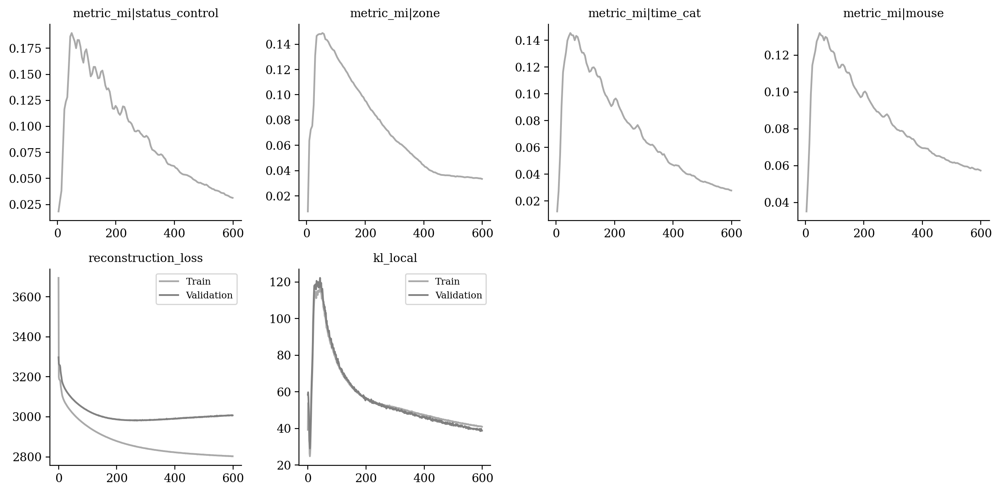

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

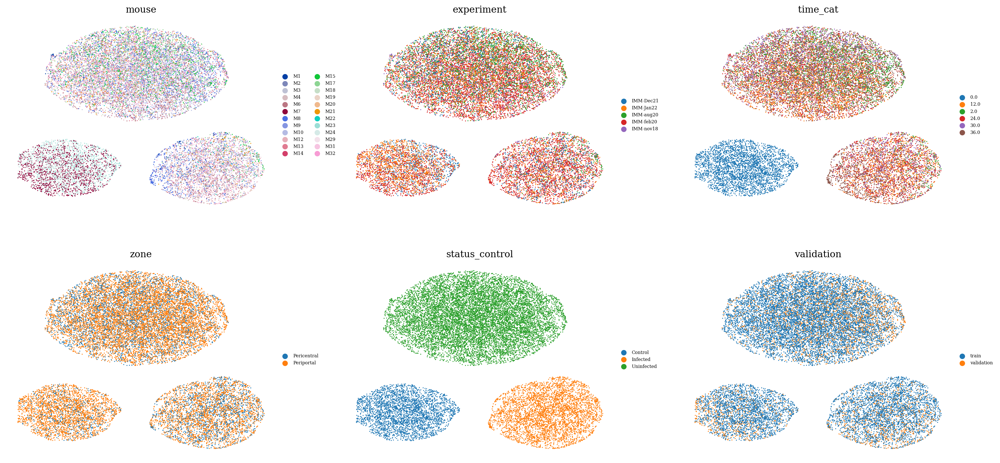

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

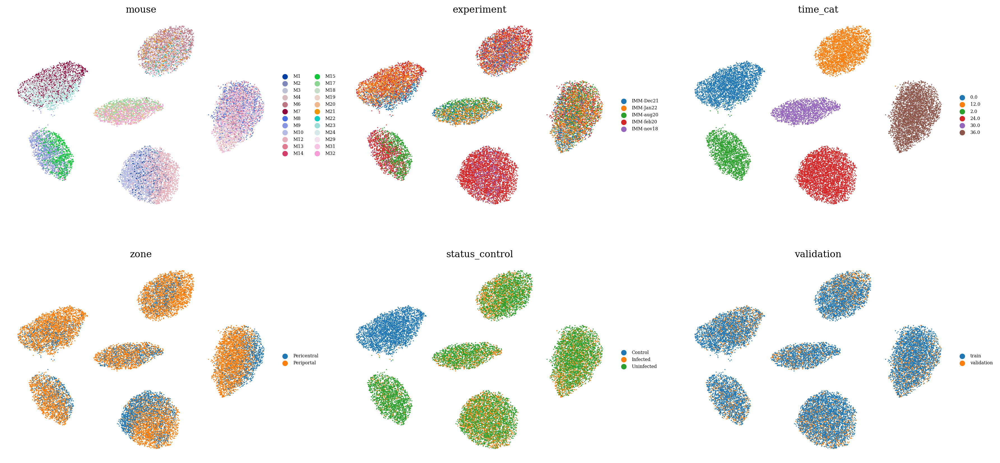

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

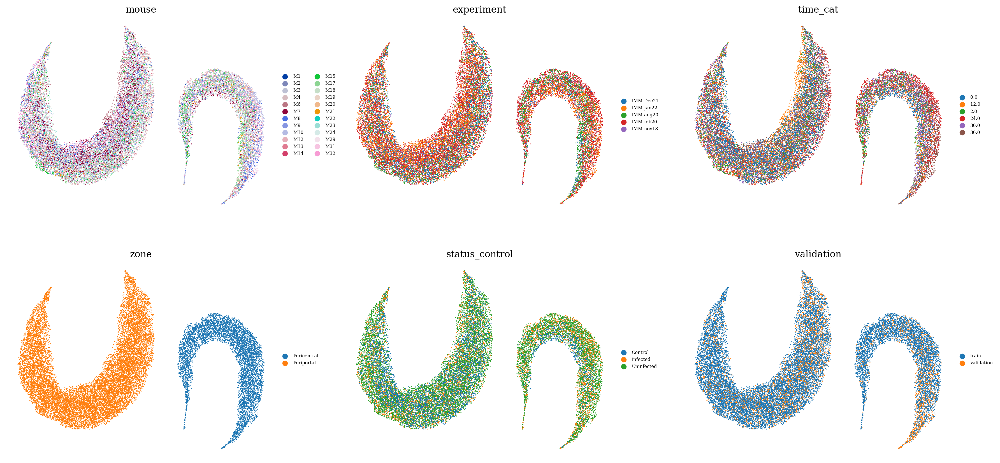

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

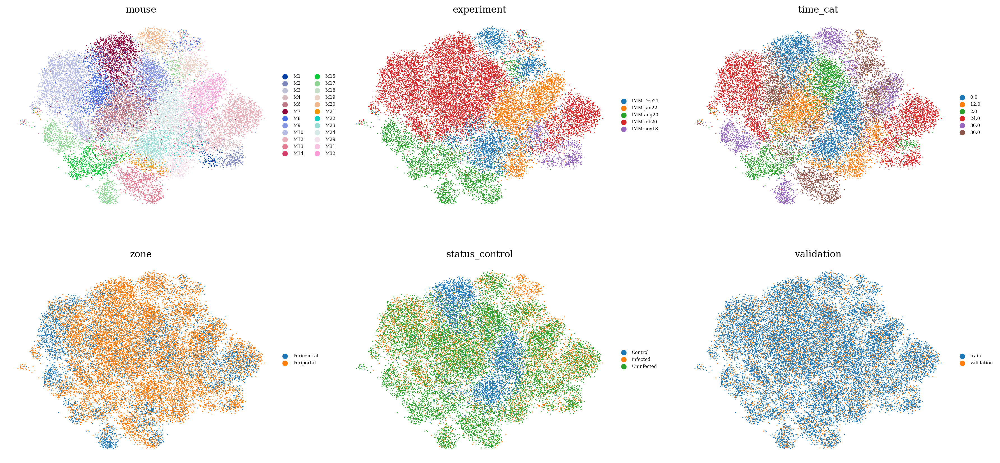

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

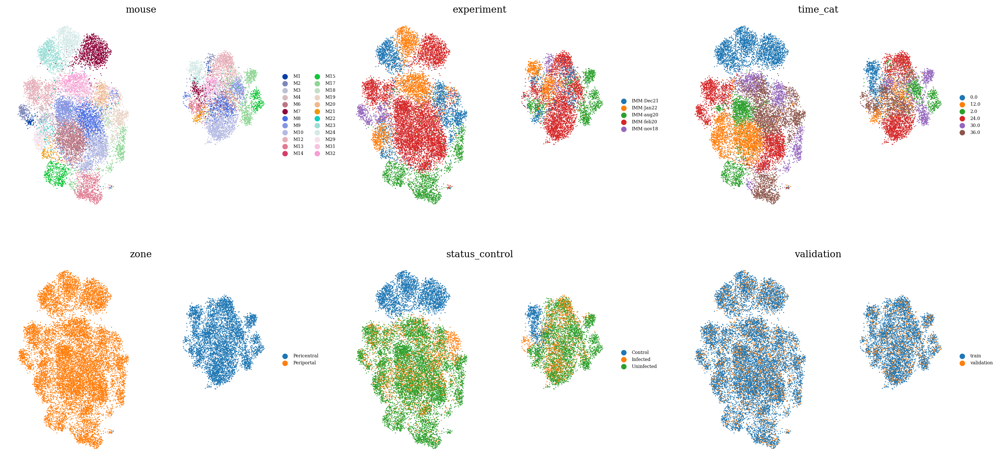

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

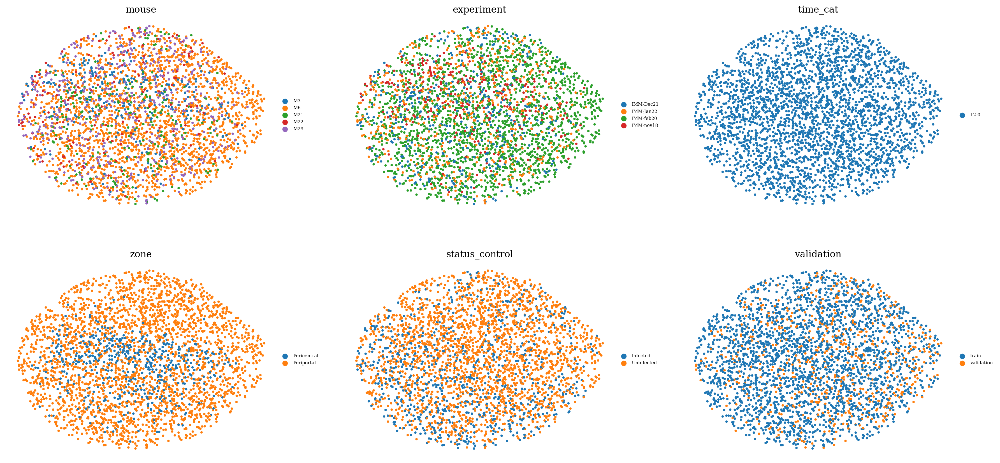

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )